<a href="https://colab.research.google.com/github/Claptar/spatialMPFC/blob/main/DE/mammals/ANOVA/ANOVA_cluster.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dependencies and files

## Install dependencies

In [1]:
!python --version

Python 3.10.11


In [ ]:
!pip install scanpy[leiden] PyComplexHeatmap  --quiet

# Необходимо, чтобы конкретно прогрузился matplotlib
import os
os.kill(os.getpid(), 9)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 20.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 5.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.0/103.0 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 20.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.5/63.5 kB 2.6 MB/s eta 0:00:00


## Imports

In [1]:
import warnings
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

sc.settings.set_figure_params(dpi=80)
#sc.set_figure_params(facecolor="white", figsize=(8, 8))
warnings.simplefilter(action='ignore', category=FutureWarning)
sc.settings.verbosity = 3

# Global variables

Нужно подключить свой гугл диск

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
dir_path = 'drive/MyDrive/Spatial project/data/'

In [4]:
de_dir_path = 'drive/MyDrive/Spatial project/results/DE/mammals/ANOVA/'

In [5]:
os.makedirs('sample_data/heatmaps', exist_ok=True)
os.makedirs('sample_data/snakeplots', exist_ok=True)

In [6]:
os.listdir(de_dir_path)

['anova_L3.csv',
 'anova_L6.csv',
 'anova_L5.csv',
 'anova_L4.csv',
 'anova_L2.csv',
 'anova_L1.csv',
 'anova_WM.csv',
 'genes_clusters.csv',
 'anova_mamm.csv',
 'ttest_mamm.csv',
 'anova_zscore_mamm.csv',
 'ttest_zscore_mamm.csv',
 'anova_human_sig_genes.csv']

In [7]:
layers = ['WM', 'L1', 'L2', 'L3', 'L4', 'L5', "L6"]
clusters = ['A', 'B', 'C', 'D', 'E', 'F']

### DE results

In [8]:
anova_res = pd.read_csv(de_dir_path + 'anova_mamm.csv', index_col=0)
anova_genes = anova_res[anova_res.p_val_adj < 0.05].index
anova_res.head()

,sum_sq,df,F,PR(>F),p_val_adj
NOC2L,0.050934,12.0,1.331623,2.198446e-01,2.964752e-01
HES4,0.047967,12.0,1.869576,5.257696e-02,9.164269e-02
AGRN,0.200630,12.0,3.592408,3.153396e-04,1.161898e-03
SDF4,0.014974,12.0,1.326877,2.223945e-01,2.993420e-01
B3GALT6,0.079358,12.0,6.536443,9.170559e-08,9.258330e-07


In [9]:
ttest_res = pd.read_csv(de_dir_path + 'ttest_mamm.csv', index_col=0)
ttest_res.head()

,gene,layer,group1,group2,score,pvalue,p_val_adj
0,AGRN,L1,human,chimp,0.205461,0.844006,0.927178
1,B3GALT6,L1,human,chimp,-1.994417,0.093144,0.309415
2,UBE2J2,L1,human,chimp,-1.303683,0.240125,0.497293
3,DVL1,L1,human,chimp,0.616069,0.560478,0.761871
4,ANKRD65,L1,human,chimp,-0.598616,0.571321,0.767981


In [10]:
anova_sig_genes = pd.read_csv(de_dir_path + 'anova_human_sig_genes.csv', index_col=0)
anova_sig_genes.head()

,layer,count,cond
gene,,,
VXN,L1,2,both
XKR4,L1,2,both
DOCK9,L1,2,both
UST,L1,2,both
MSI2,L1,2,both


## Load pseudobulks

In [11]:
pb_dir_path = 'drive/MyDrive/Spatial project/data/pseudobulks/'

In [12]:
os.listdir(pb_dir_path)

['expression_chimp.csv',
 'expression_human.csv',
 'expression_macaque.csv',
 'expression_spatial_libd_human.csv',
 'expression_sum_chimp.csv',
 'expression_mean_chimp.csv',
 'annotation_chimp.csv',
 'expression_sum_human.csv',
 'expression_mean_human.csv',
 'annotation_human.csv',
 'expression_sum_macaque.csv',
 'expression_mean_macaque.csv',
 'annotation_macaque.csv',
 'expression_sum_spatial_libd_human.csv',
 'expression_mean_spatial_libd_human.csv',
 'annotation_spatial_libd_human.csv',
 'pb_age_sample_norm.h5ad',
 'pb_mamm.h5ad',
 'pb_age.h5ad',
 'pb_mamm_sample_norm.h5ad',
 'pb_mamm_sample_norm_zscore.h5ad',
 'pb_mamm_sample_norm_filtered.h5ad',
 'pb_mamm_sample_zscore_filtered.h5ad']

In [13]:
adata_pb_norm = sc.read_h5ad(pb_dir_path + 'pb_mamm_sample_norm_filtered.h5ad')
adata_pb_norm

AnnData object with n_obs × n_vars = 94 × 9177
    obs: 'layer', 'sample_id', 'condition', 'lib_size', 'log_lib_size'
    uns: 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [14]:
adata_pb = sc.read_h5ad(pb_dir_path + 'pb_mamm.h5ad')
adata_pb = adata_pb[:, adata_pb_norm.var_names]
adata_pb

View of AnnData object with n_obs × n_vars = 94 × 9177
    obs: 'layer', 'sample_id', 'condition'

### Preprocess pseudobulk

In [15]:
# preprocess
adata_pb.raw = adata_pb
sc.pp.normalize_total(adata_pb, target_sum=1e4)
sc.pp.log1p(adata_pb)
sc.pp.pca(adata_pb)

normalizing counts per cell
    finished (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:00)


In [16]:
mito = adata_pb.var_names.str.startswith('MT-')
hb = adata_pb.var_names.str.contains(("^HB[AB]"))
rb = adata_pb.var_names.str.contains(("^RP[LS]"))
remove = mito | hb | rb
genes_to_remove = adata_pb.var_names[remove].tolist()

keep = np.invert(remove)
print(sum(remove))

adata_pb = adata_pb[:,keep]

66


# Кластеризация

## PCA

In [17]:
adata_norm_anova = adata_pb_norm[:, adata_pb_norm.var.index & anova_genes]
df = pd.DataFrame(adata_norm_anova.X, columns=adata_norm_anova.var_names, index=adata_norm_anova.obs_names)
df.head()

,AGRN,B3GALT6,UBE2J2,DVL1,ANKRD65,VWA1,TMEM240,SSU72,GNB1,TMEM52,...,PFKL,CFAP410,ADARB1,COL18A1,COL6A2,SPATC1L,LSS,DIP2A,S100B,PRMT2
WM.human_759,-0.043517,0.019739,0.073402,-0.059303,-0.017728,0.043856,-0.014294,-0.066947,-0.044555,-0.036660,...,-0.007565,-0.033007,-0.084815,0.058852,-0.030160,0.062820,0.006484,0.194320,-0.013049,0.086257
L5.human_759,0.081046,0.081751,0.024792,0.065203,-0.037591,0.018296,0.008752,0.040695,-0.005910,-0.017086,...,0.030875,-0.005560,0.123795,-0.092655,0.024885,0.031169,-0.011958,-0.003846,-0.163199,-0.036209
L2.human_759,-0.094585,-0.015252,-0.041863,0.044455,0.020012,-0.028660,-0.043676,-0.034586,0.058010,0.039615,...,-0.003073,0.021368,-0.034977,-0.010455,-0.067578,0.010243,-0.086682,-0.073351,-0.099099,0.033290
L3.human_759,0.055989,-0.030906,-0.005798,0.020492,0.045711,-0.016184,-0.026563,-0.003668,0.082764,0.001038,...,0.002126,0.042676,0.030607,-0.077531,-0.036660,-0.056161,-0.006626,-0.077773,-0.158475,-0.059096
L1.human_759,-0.060537,-0.022040,-0.051892,-0.046623,0.016406,-0.019107,-0.016515,-0.054316,-0.183437,-0.025866,...,-0.038251,-0.011802,-0.088431,0.269646,0.174653,-0.047335,0.132053,0.009784,0.679253,0.060213


In [18]:
sample_order = dict()
for cond in ['human', 'chimp', 'macaque']:
    samples = df.loc[df.index.str.contains(cond)].index
    order = samples.sort_values()
    order_laminar = order[order.str.contains('L')].tolist()
    order_wm = order[order.str.contains('WM')].tolist()
    sample_order[cond] = order_wm + order_laminar
sample_order['all'] = sample_order['human'] + sample_order['chimp'] + sample_order['macaque']
df = df.loc[sample_order['all']]

In [19]:
import plotly.express as px
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
components = pca.fit_transform(adata_norm_anova.X.T)

In [20]:
fig = px.scatter(components, x=0, y=1, hover_name=adata_norm_anova.var_names)
fig.show()

## Кластеризация всех значимых генов

### Иерархическая кластеризация

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



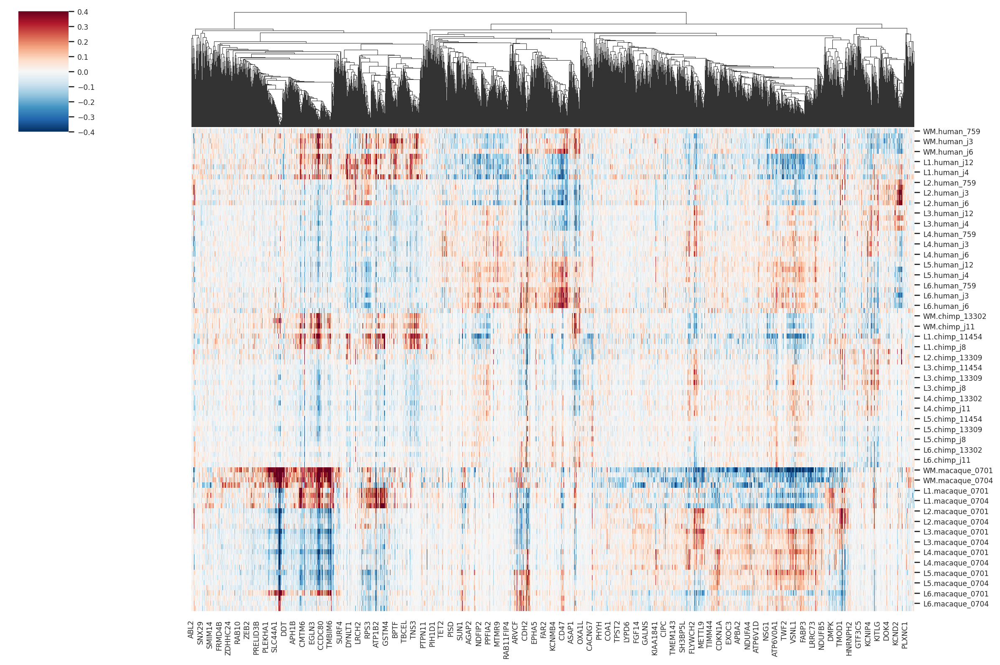

In [21]:
sns.set(font_scale=0.7)
sns.clustermap(df, figsize=(15, 10), cmap="RdBu_r", center=0, vmax=0.4, vmin=-0.4, metric='cosine', annot_kws={"size": 2}, row_cluster=False).savefig('sample_data/heatmaps/heatmap_norm.png')

<Axes: >

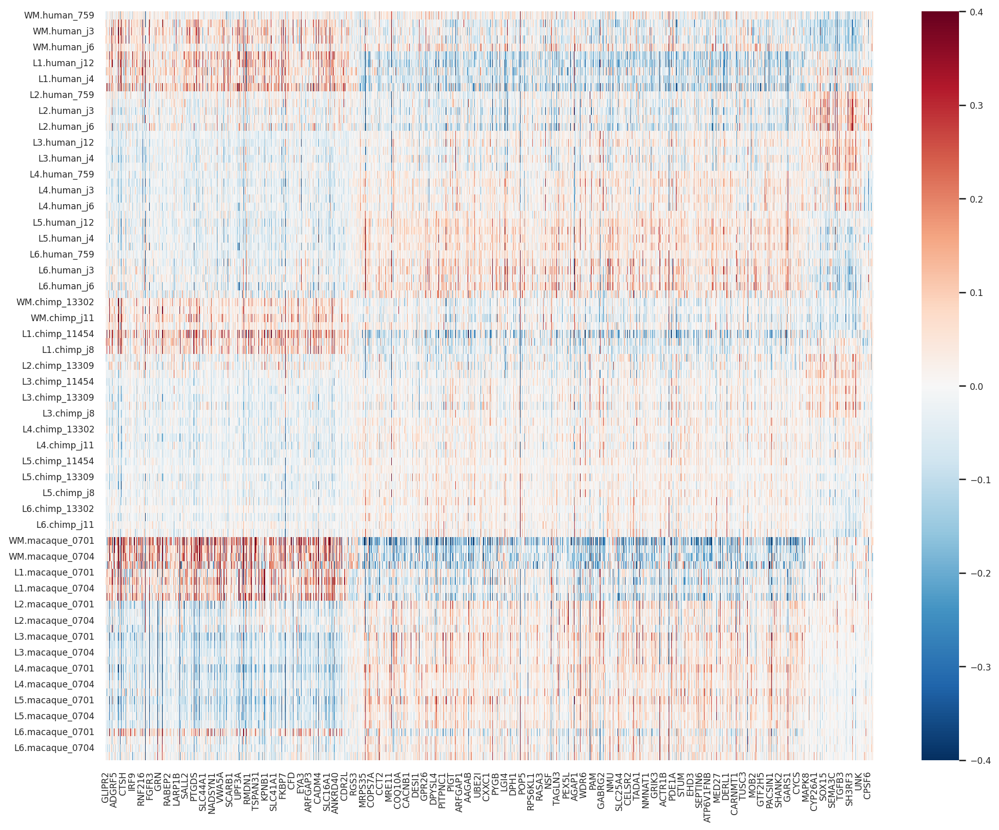

In [22]:
from sklearn.cluster import AgglomerativeClustering

clustering = AgglomerativeClustering(n_clusters=6, metric='cosine', linkage='average')
clustering.fit(df.T)

labels = pd.Series(clustering.labels_, index=df.columns)
order = labels.sort_values().index

#sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)

<Axes: >

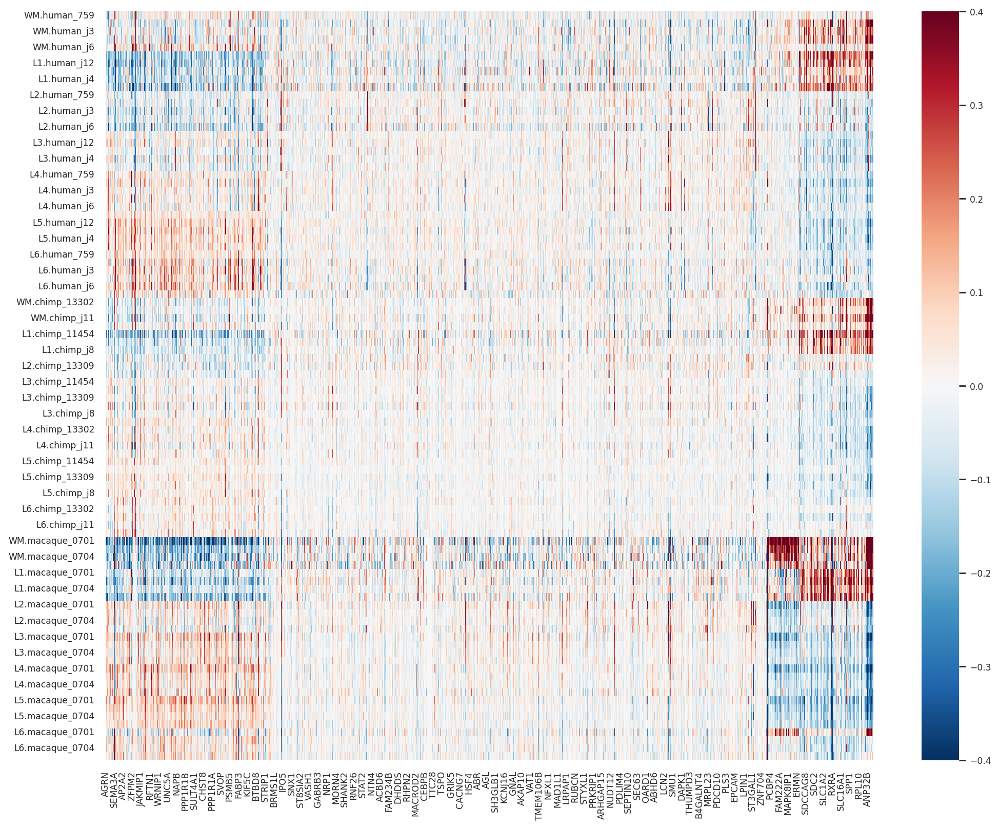

In [23]:
from sklearn.cluster import AgglomerativeClustering

clustering = AgglomerativeClustering(n_clusters=6)
clustering.fit(df.T)

labels = pd.Series(clustering.labels_, index=df.columns)
order = labels.sort_values().index

#sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)

Сделаем кластеризацию по слоям

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



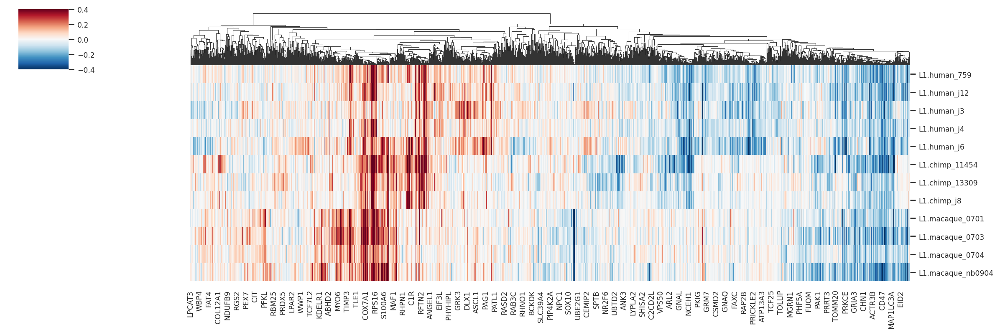

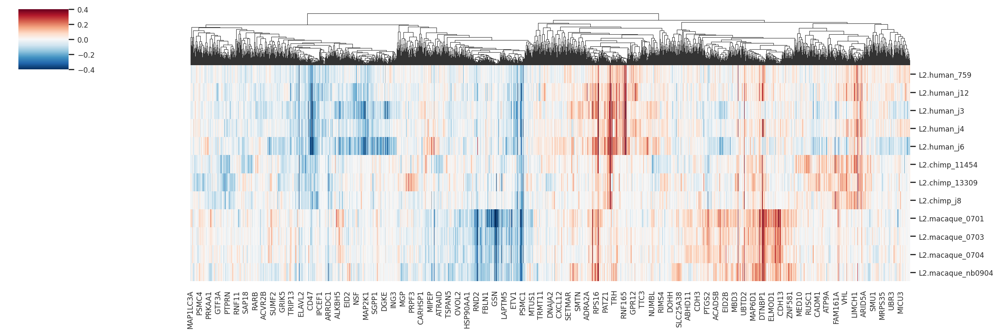

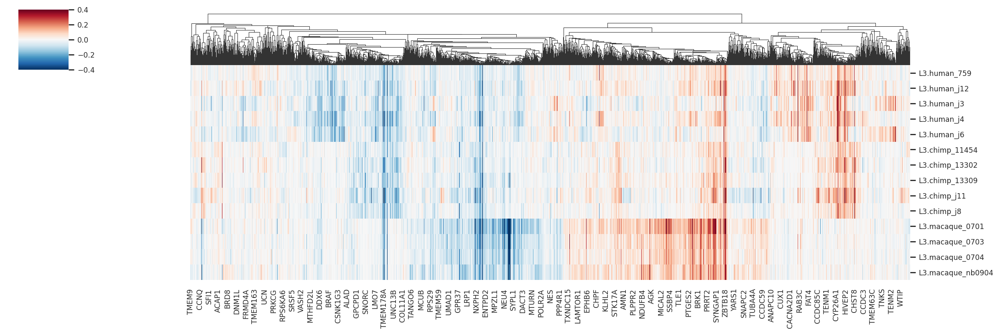

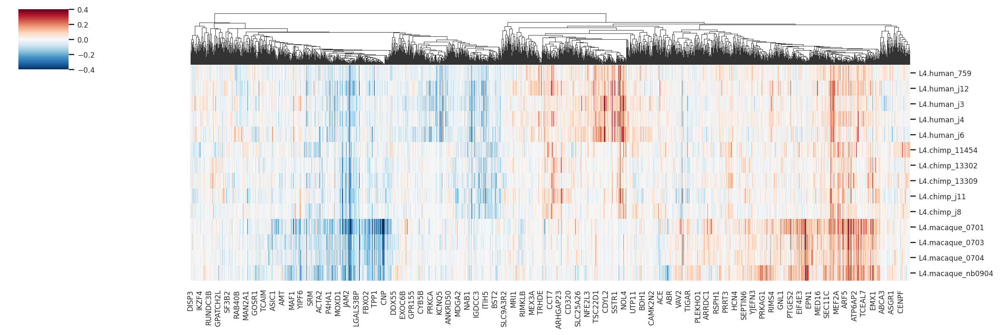

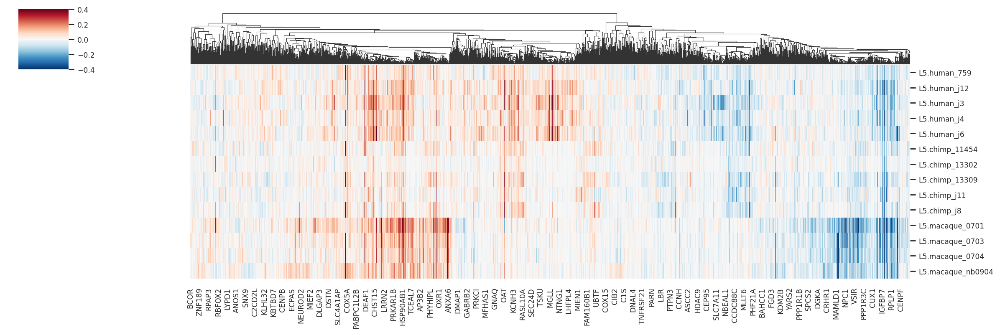

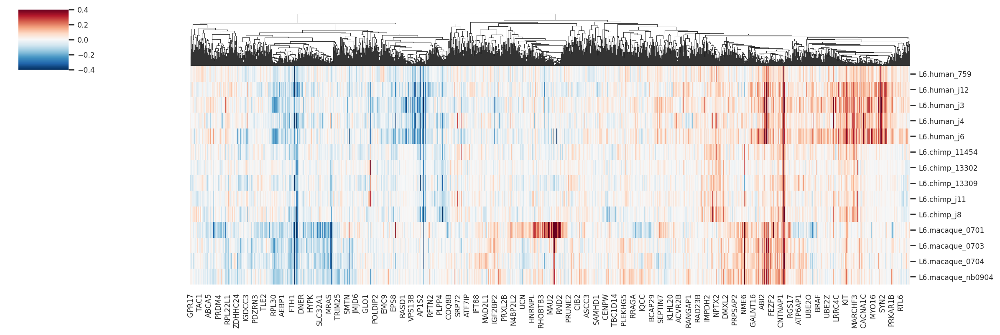

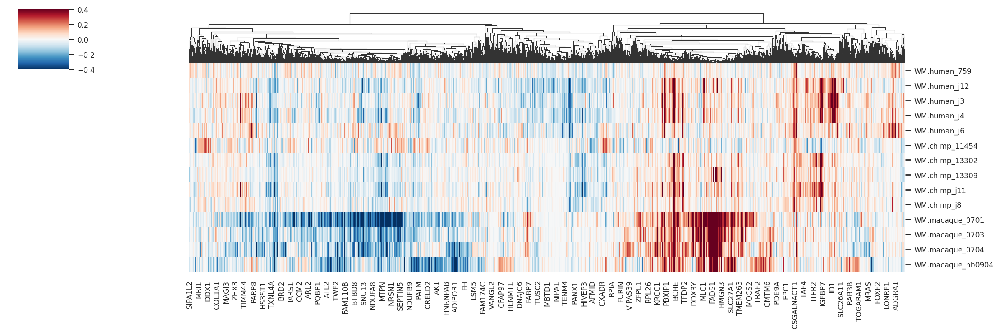

In [24]:
for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    df_layer = df.loc[df.index.str.contains(layer)]
    sns.clustermap(df_layer, figsize=(15, 5), cmap="RdBu_r", center=0,
                   vmax=0.4, vmin=-0.4, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/heatmap_norm_{layer}.png')

Сделаем кластеризацию по видам

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



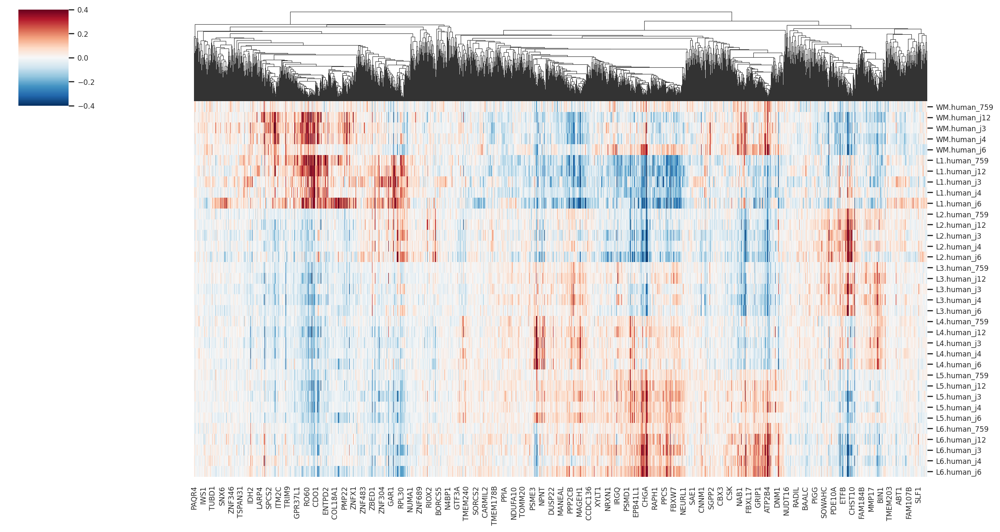

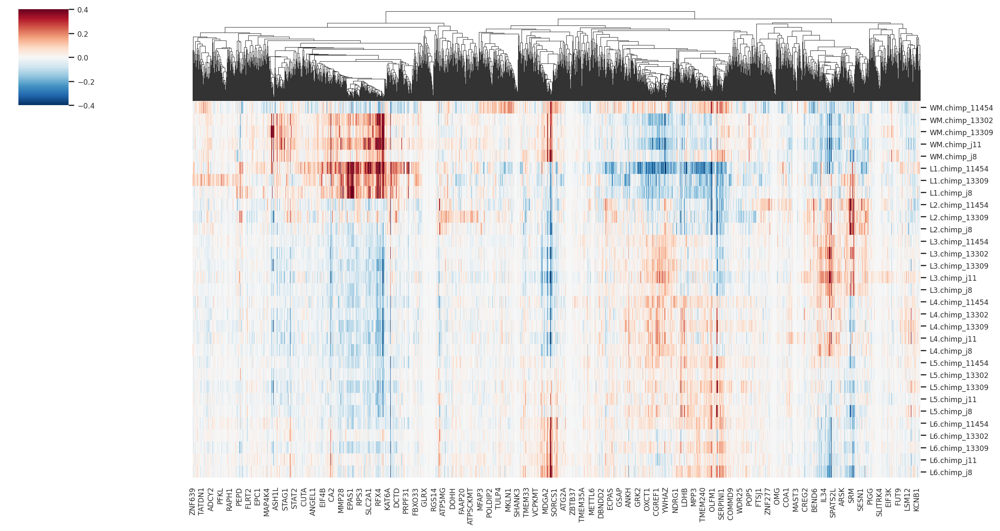

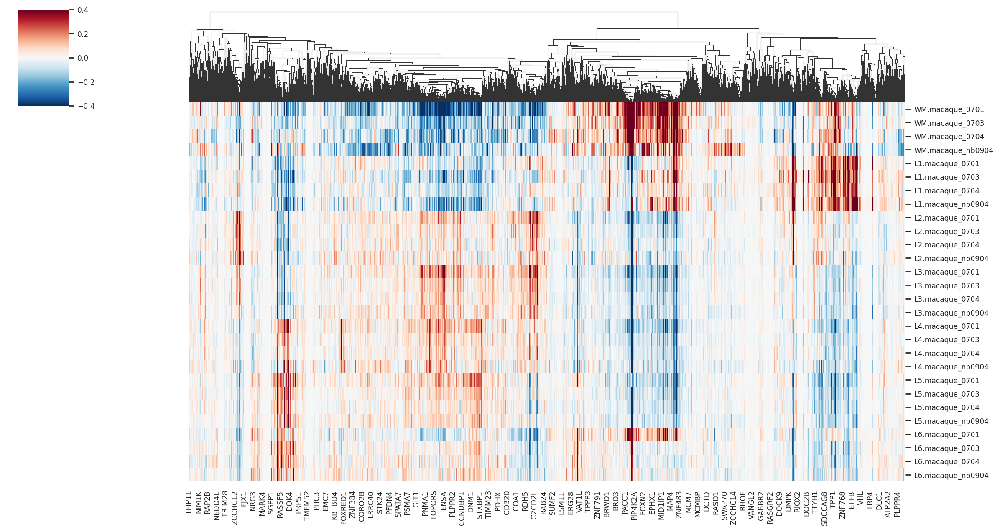

In [25]:
for cond in ['human', 'chimp', 'macaque']:
    df_cond = df.loc[df.index.str.contains(cond)]
    max_val = df_cond.max(axis=0).sort_values()
    df_cond = df_cond[max_val[max_val > 0].index.tolist()]
    sns.clustermap(df_cond, figsize=(15, 8), cmap="RdBu_r", center=0,
                   vmax=0.4, vmin=-0.4, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/heatmap_norm_{cond}.png')

### Спектральная

In [26]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df.T, metric='cosine') + 1
clustering = SpectralClustering(n_clusters=6, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=6)

In [27]:
labels = pd.Series(clustering.labels_, index=df.columns)
order = labels.sort_values().index

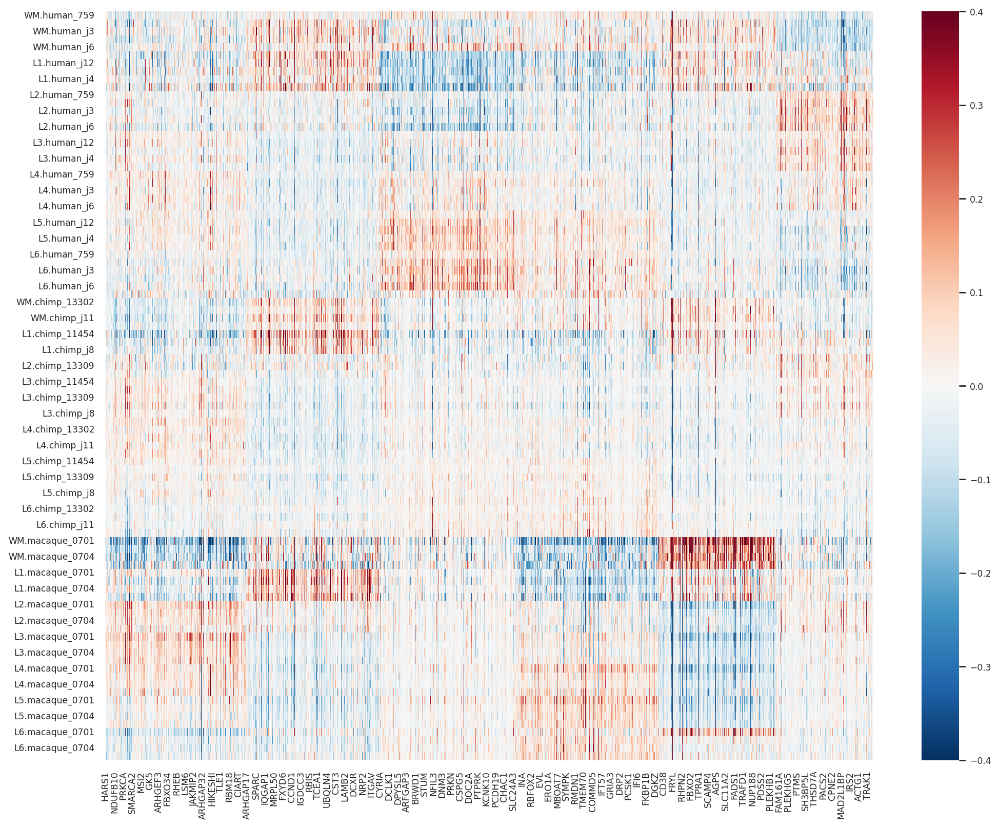

In [28]:

sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)
plt.savefig('sample_data/heatmaps/heatmap_spectr_all.png', bbox_inches='tight')

In [29]:
sample_mean = pd.DataFrame(index=df.index, columns=df.columns)

In [30]:
for label in labels.unique():
    genes = labels[labels == label].index
    for gene in genes:
        sample_mean[gene] = df[genes].mean(axis=1)
sample_mean.head()

,AGRN,B3GALT6,UBE2J2,DVL1,ANKRD65,VWA1,TMEM240,SSU72,GNB1,TMEM52,...,PFKL,CFAP410,ADARB1,COL18A1,COL6A2,SPATC1L,LSS,DIP2A,S100B,PRMT2
WM.human_759,0.019115,0.019115,0.022592,0.011285,-0.038957,0.011285,-0.015361,0.022592,0.019115,0.019115,...,0.011285,-0.015361,0.019115,0.011285,0.011285,-0.015361,0.008986,0.022592,0.011285,0.022592
WM.human_j12,-0.044524,-0.044524,-0.007923,0.074211,-0.089792,0.074211,-0.025868,-0.007923,-0.044524,-0.044524,...,0.074211,-0.025868,-0.044524,0.074211,0.074211,-0.025868,0.047434,-0.007923,0.074211,-0.007923
WM.human_j3,-0.012303,-0.012303,0.000466,0.095317,-0.080442,0.095317,0.002458,0.000466,-0.012303,-0.012303,...,0.095317,0.002458,-0.012303,0.095317,0.095317,0.002458,0.047691,0.000466,0.095317,0.000466
WM.human_j4,-0.015293,-0.015293,-0.003437,0.080714,-0.084870,0.080714,-0.031148,-0.003437,-0.015293,-0.015293,...,0.080714,-0.031148,-0.015293,0.080714,0.080714,-0.031148,0.043546,-0.003437,0.080714,-0.003437
WM.human_j6,0.060507,0.060507,0.040170,0.033079,-0.074319,0.033079,-0.002886,0.040170,0.060507,0.060507,...,0.033079,-0.002886,0.060507,0.033079,0.033079,-0.002886,0.013793,0.040170,0.033079,0.040170


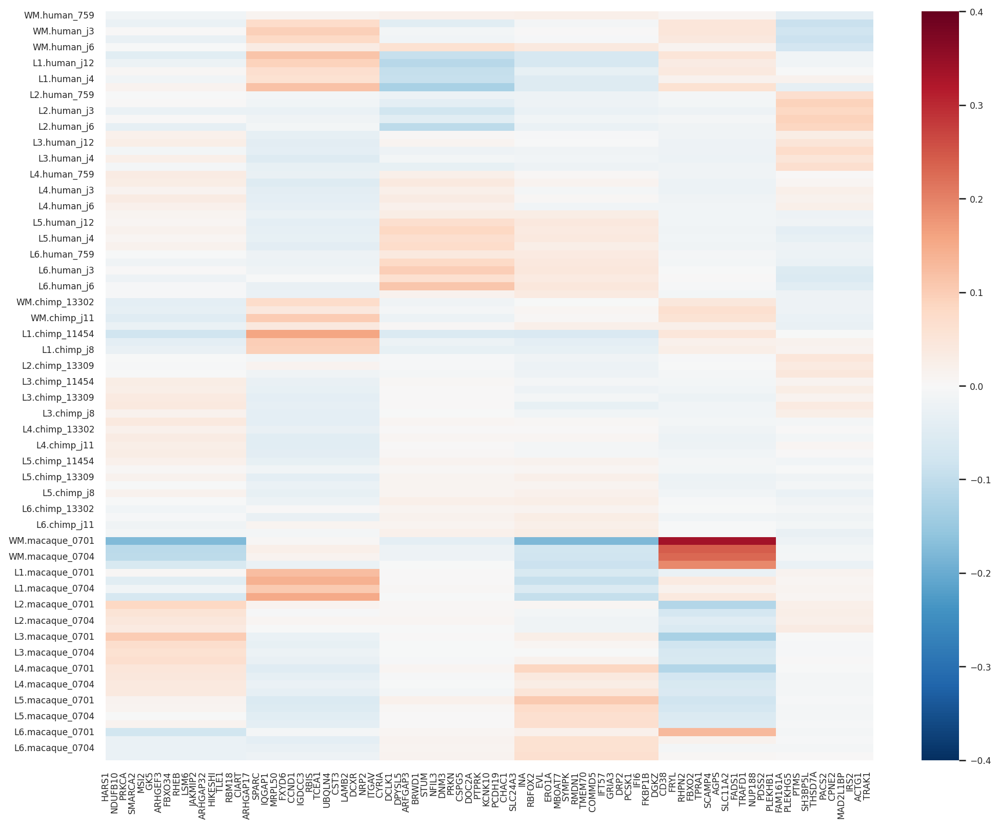

In [31]:
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(sample_mean.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)
plt.savefig('sample_data/heatmaps/heatmap_spectr_all_mean.png', bbox_inches='tight')

## Кластеризация генов значимых для человека

In [32]:
# посчитаем число уникальных генов
human_specific_genes = anova_sig_genes.index.unique().tolist()
len(human_specific_genes)

2402

<Axes: xlabel='layer', ylabel='count'>

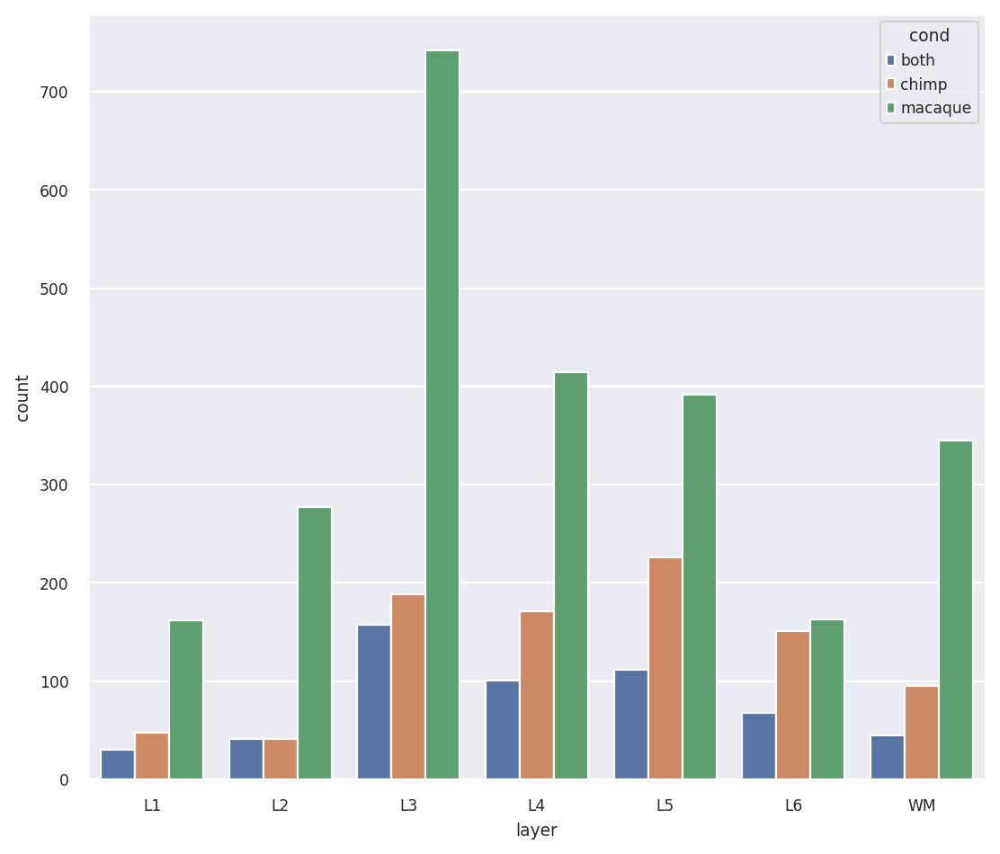

In [33]:
fig, ax = plt.subplots(figsize=(8, 7))
sns.countplot(data=anova_sig_genes, x="layer", hue='cond', ax=ax)

### Иерархическая кластеризация

In [34]:
df_hs = df[human_specific_genes].copy()
df_hs.head()

,VXN,XKR4,DOCK9,UST,MSI2,NPAS3,NGB,TMEM121,TSFM,HS3ST4,...,RHOBTB1,RHPN1,RNF34,ROCK2,PLEKHA1,PLPP7,PPP4C,PRKCI,PRPF6,PRRT3
WM.human_759,-0.001253,0.137043,-0.035623,-0.010431,0.058308,-0.019822,0.073025,0.079386,-0.003300,0.280137,...,-0.090732,-0.000727,-0.037329,0.052382,0.059215,0.040246,-0.079488,-0.080315,-0.099355,0.000176
WM.human_j12,-0.001793,0.024949,-0.103842,0.007911,0.242536,0.121932,-0.050084,0.000220,-0.015823,0.408712,...,-0.057335,0.112429,-0.082624,0.071425,-0.123298,-0.003794,-0.033311,-0.028559,-0.030729,-0.009404
WM.human_j3,-0.004376,0.138618,-0.078281,-0.012923,0.246503,0.234896,0.017447,-0.058111,0.009647,0.302142,...,-0.017941,0.070530,-0.040386,0.138369,-0.015067,0.012875,-0.071688,-0.048165,-0.066218,0.031004
WM.human_j4,-0.001413,-0.010746,-0.161150,-0.038087,0.093969,0.149936,0.036529,-0.056292,-0.008251,0.271307,...,-0.061876,0.031254,-0.025527,0.142840,-0.001496,-0.009317,-0.096247,-0.058913,-0.024563,-0.038509
WM.human_j6,-0.000987,0.240905,-0.017398,-0.167016,0.022730,0.131422,0.057162,0.027936,0.018600,0.579966,...,-0.076982,0.034106,-0.127856,0.024023,-0.020245,-0.009196,-0.116996,-0.051158,-0.072915,0.001779


/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



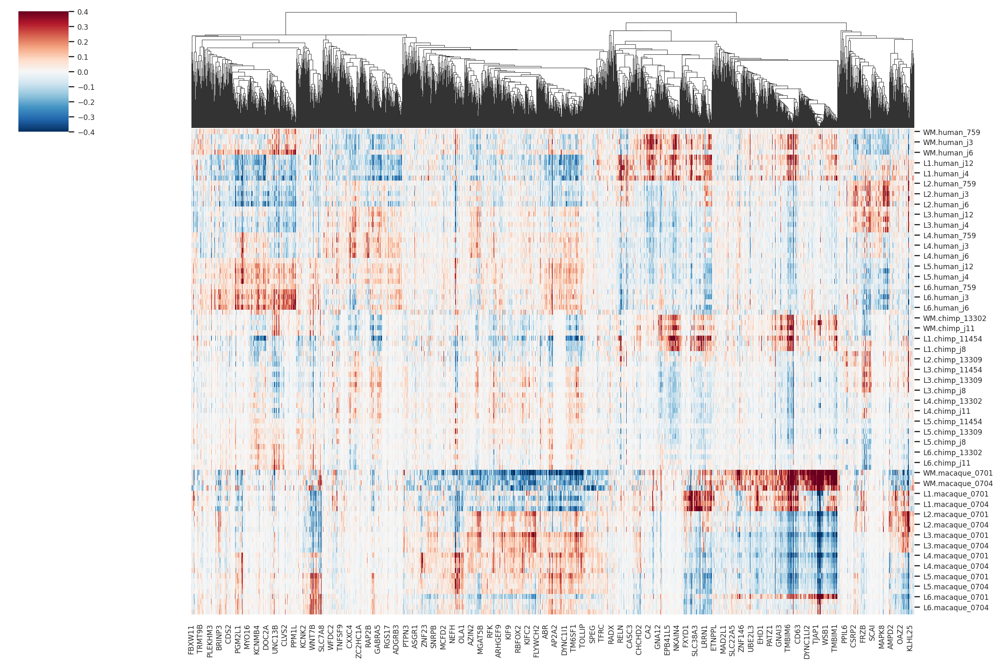

In [35]:
sns.clustermap(df_hs.loc[sample_order['all']], figsize=(15, 10), cmap="RdBu_r", metric='cosine', center=0, vmax=0.4, vmin=-0.4, annot_kws={"size": 2}, row_cluster=False).savefig('sample_data/heatmaps/heatmap_norm_hs.png')

<Axes: >

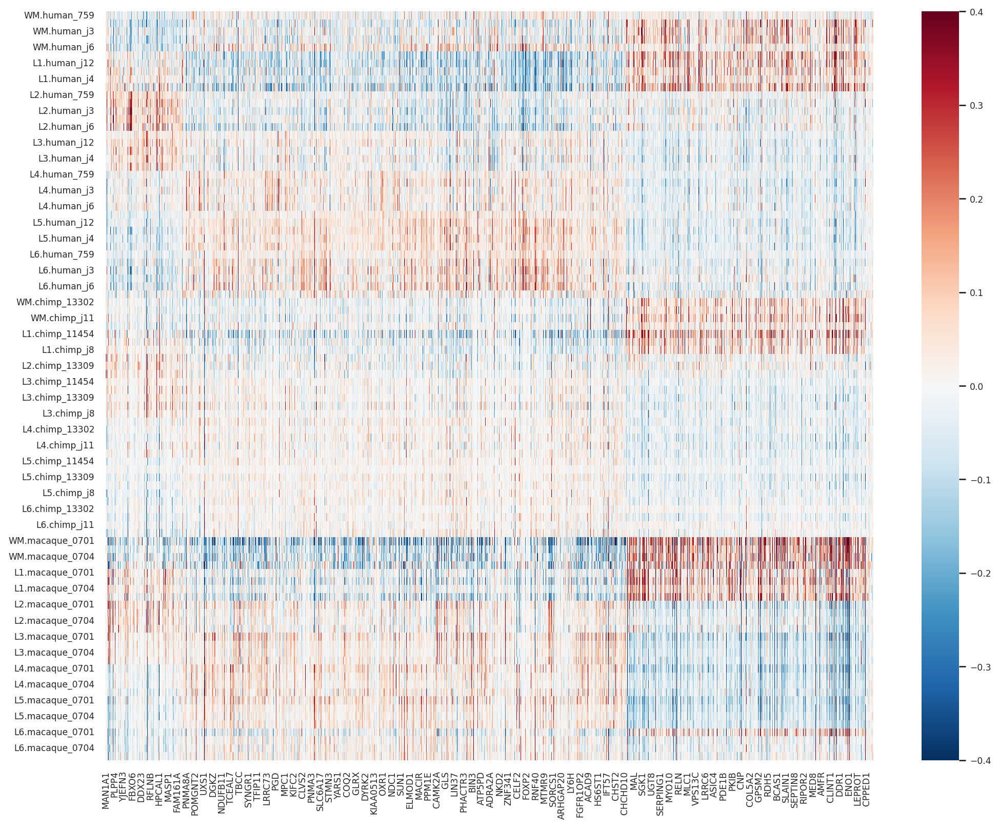

In [36]:
from sklearn.cluster import AgglomerativeClustering

clustering = AgglomerativeClustering(n_clusters=6, metric='cosine', linkage='average')
clustering.fit(df_hs.T)

labels = pd.Series(clustering.labels_, index=df_hs.columns)
order = labels.sort_values().index

#sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df_hs.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)

<Axes: >

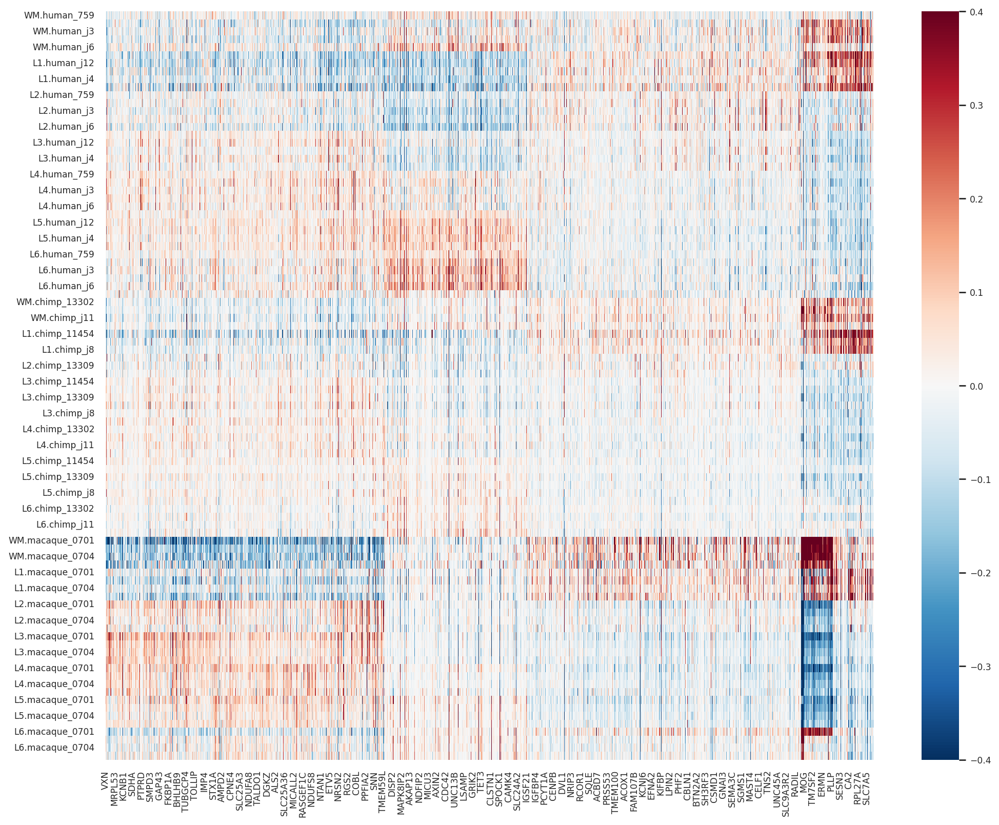

In [37]:
from sklearn.cluster import AgglomerativeClustering

clustering = AgglomerativeClustering(n_clusters=6)
clustering.fit(df_hs.T)

labels = pd.Series(clustering.labels_, index=df_hs.columns)
order = labels.sort_values().index

#sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df_hs.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)

Сделаем кластеризацию по слоям

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



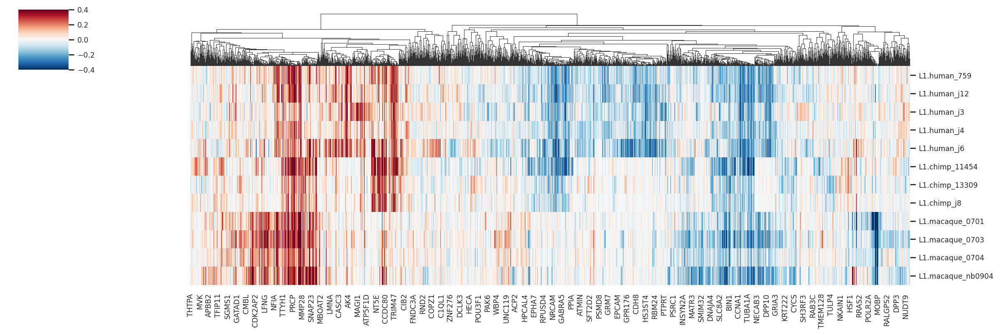

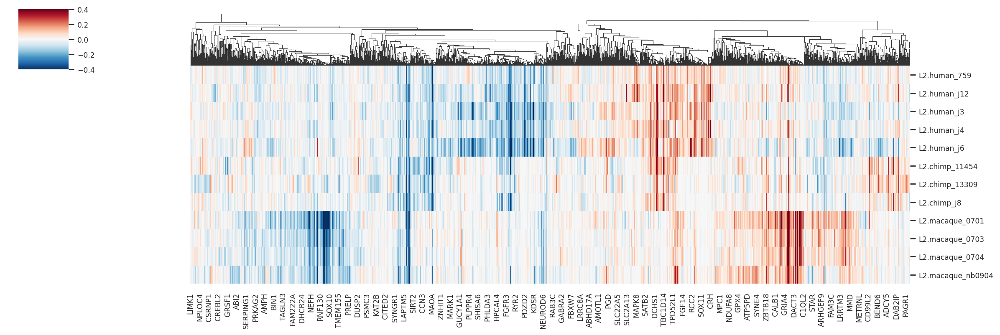

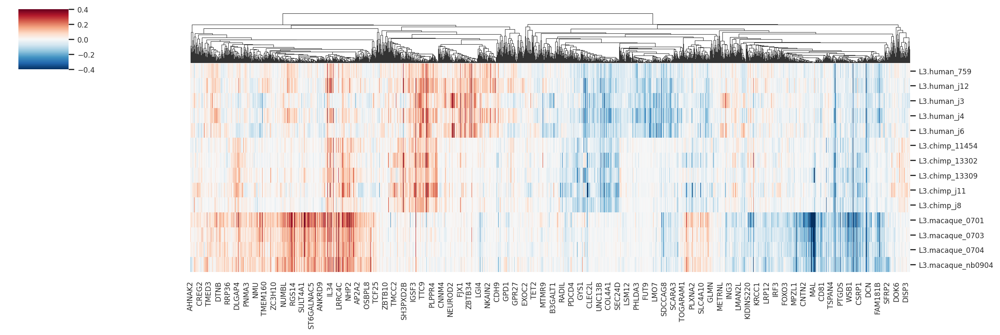

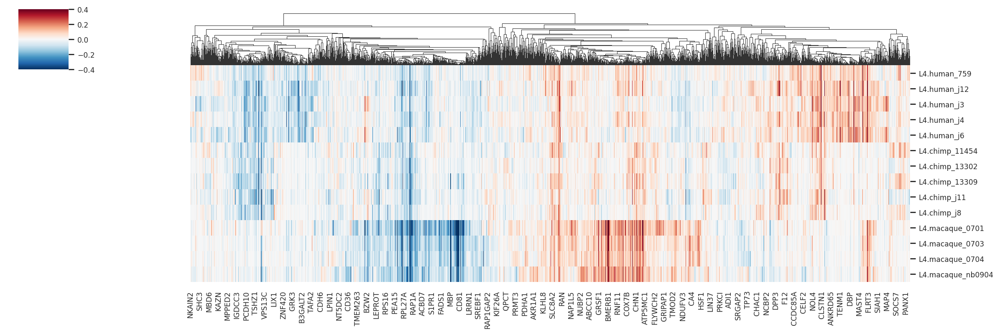

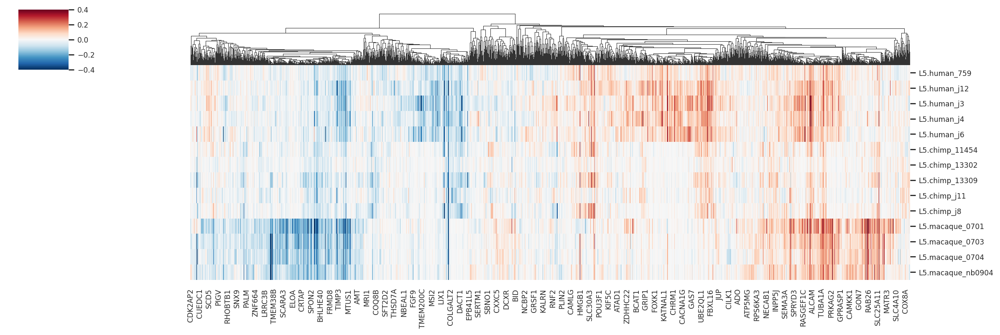

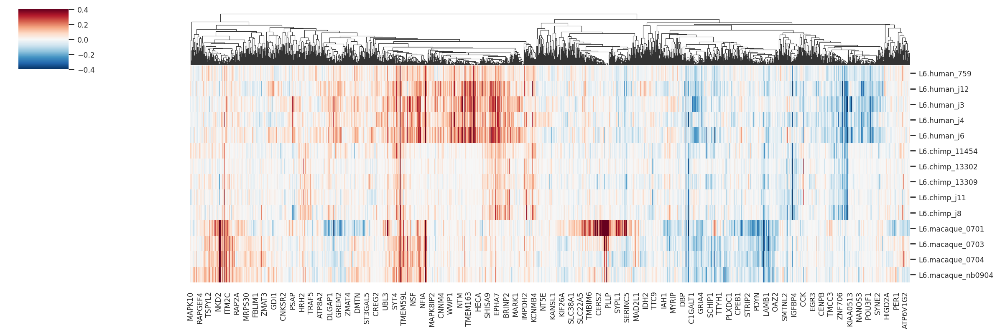

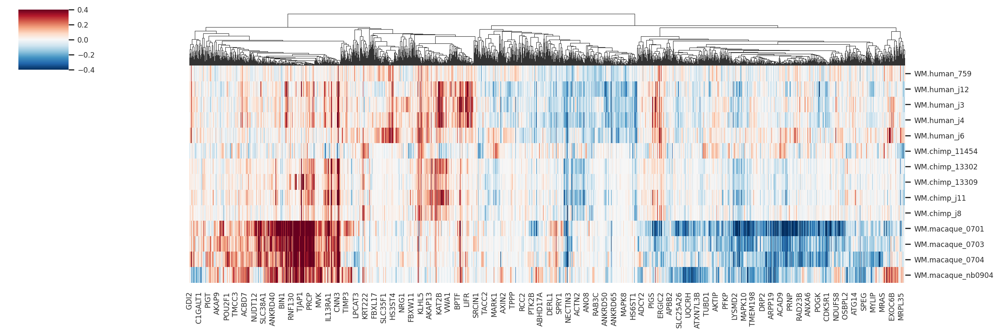

In [38]:
for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    df_layer = df_hs.loc[df_hs.index.str.contains(layer)]
    sns.clustermap(df_layer, figsize=(15, 5), cmap="RdBu_r", center=0,
                   vmax=0.4, vmin=-0.4, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/heatmap_norm_hs_{layer}.png')

Сделаем кластеризацию по видам

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



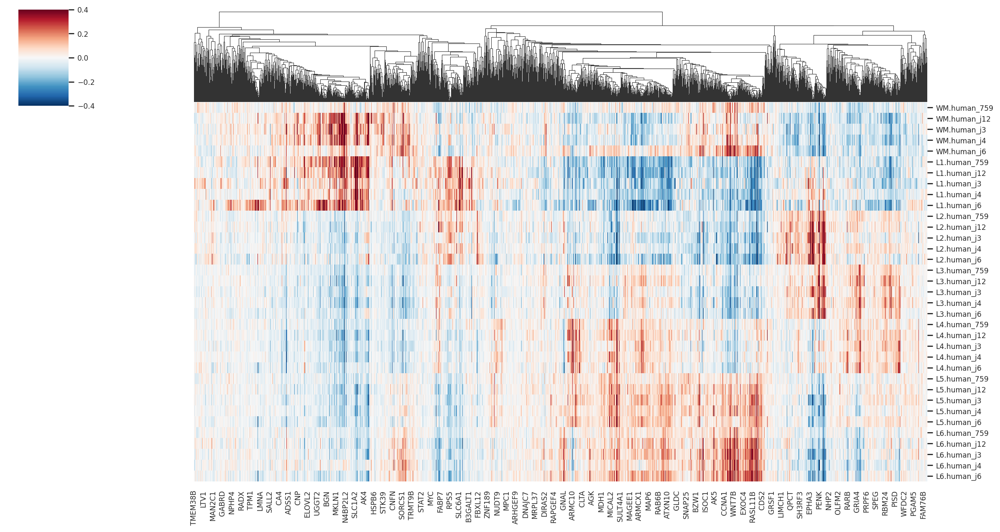

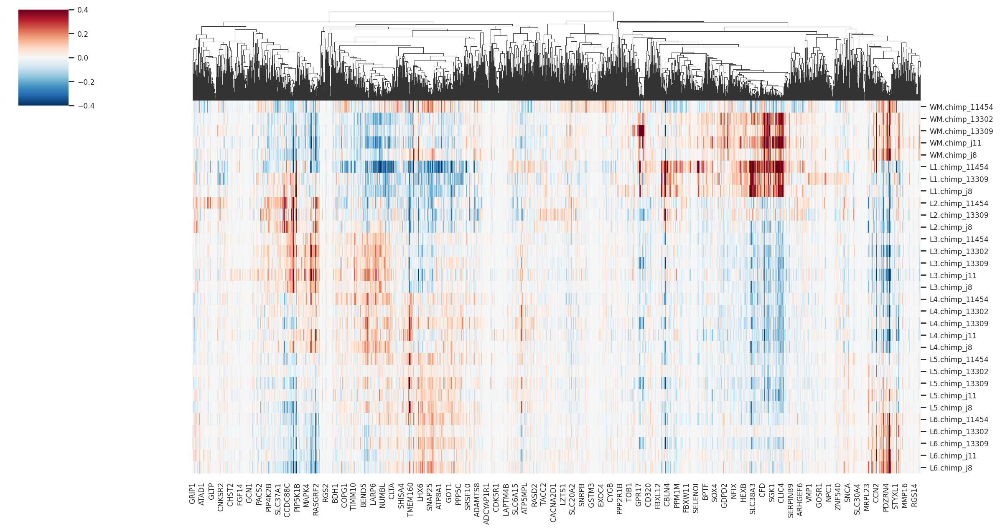

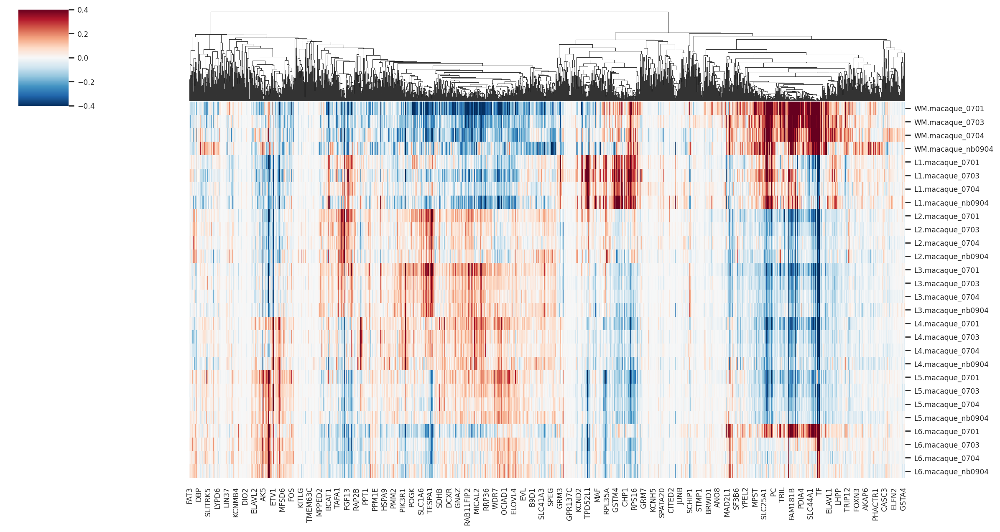

In [39]:
for cond in ['human', 'chimp', 'macaque']:
    df_cond = df_hs.loc[df_hs.index.str.contains(cond)]
    max_val = df_cond.max(axis=0).sort_values()
    df_cond = df_cond[max_val[max_val > 0].index.tolist()]
    sns.clustermap(df_cond, figsize=(15, 8), cmap="RdBu_r", center=0,
                   vmax=0.4, vmin=-0.4, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'sample_data/heatmaps/heatmap_norm_hs_{cond}.png')

### Спектральная кластеризация

In [40]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df_hs.T, metric='cosine') + 1
clustering = SpectralClustering(n_clusters=6, gamma=1, affinity='precomputed', random_state=4)
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=6,
                   random_state=4)

In [41]:
labels = pd.Series(clustering.labels_, index=df_hs.columns).map({0: 'C', 1: 'E', 2: 'D', 3: 'B', 4: 'A', 5: 'F'})
order = labels.sort_values().index

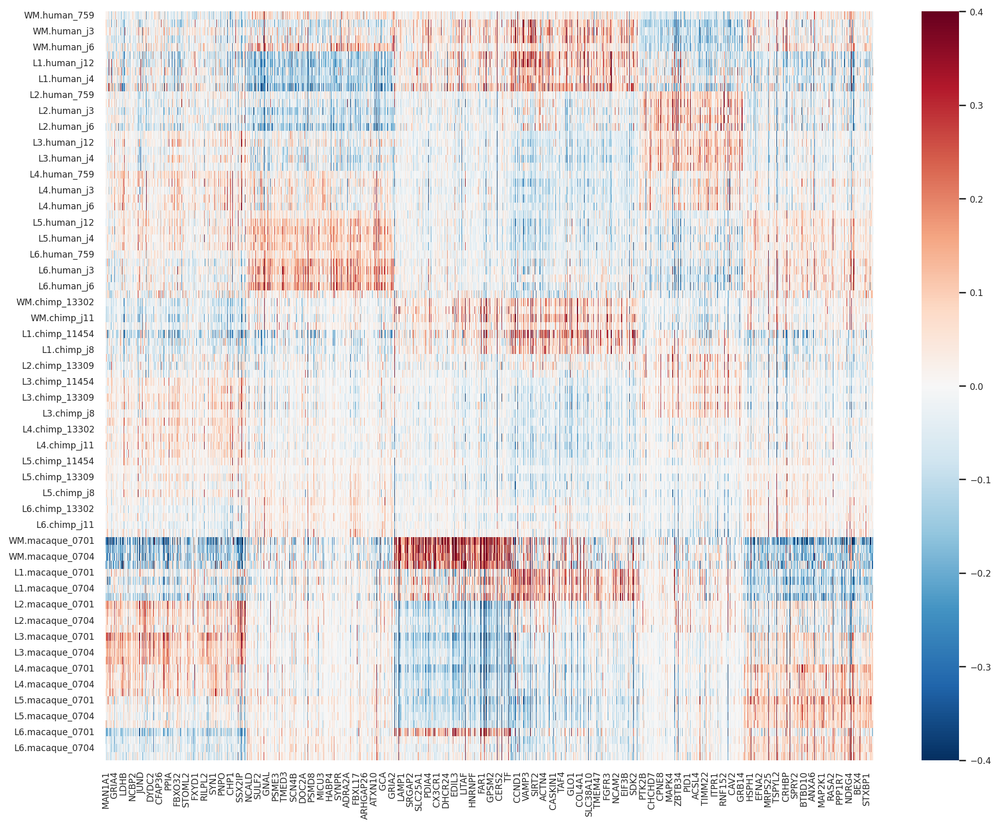

In [42]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df_hs.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)
plt.savefig('sample_data/heatmaps/heatmap_spectr_hs.png', bbox_inches='tight')

#### Snakeplot

In [43]:
df_hs.head()

,VXN,XKR4,DOCK9,UST,MSI2,NPAS3,NGB,TMEM121,TSFM,HS3ST4,...,RHOBTB1,RHPN1,RNF34,ROCK2,PLEKHA1,PLPP7,PPP4C,PRKCI,PRPF6,PRRT3
WM.human_759,-0.001253,0.137043,-0.035623,-0.010431,0.058308,-0.019822,0.073025,0.079386,-0.003300,0.280137,...,-0.090732,-0.000727,-0.037329,0.052382,0.059215,0.040246,-0.079488,-0.080315,-0.099355,0.000176
WM.human_j12,-0.001793,0.024949,-0.103842,0.007911,0.242536,0.121932,-0.050084,0.000220,-0.015823,0.408712,...,-0.057335,0.112429,-0.082624,0.071425,-0.123298,-0.003794,-0.033311,-0.028559,-0.030729,-0.009404
WM.human_j3,-0.004376,0.138618,-0.078281,-0.012923,0.246503,0.234896,0.017447,-0.058111,0.009647,0.302142,...,-0.017941,0.070530,-0.040386,0.138369,-0.015067,0.012875,-0.071688,-0.048165,-0.066218,0.031004
WM.human_j4,-0.001413,-0.010746,-0.161150,-0.038087,0.093969,0.149936,0.036529,-0.056292,-0.008251,0.271307,...,-0.061876,0.031254,-0.025527,0.142840,-0.001496,-0.009317,-0.096247,-0.058913,-0.024563,-0.038509
WM.human_j6,-0.000987,0.240905,-0.017398,-0.167016,0.022730,0.131422,0.057162,0.027936,0.018600,0.579966,...,-0.076982,0.034106,-0.127856,0.024023,-0.020245,-0.009196,-0.116996,-0.051158,-0.072915,0.001779


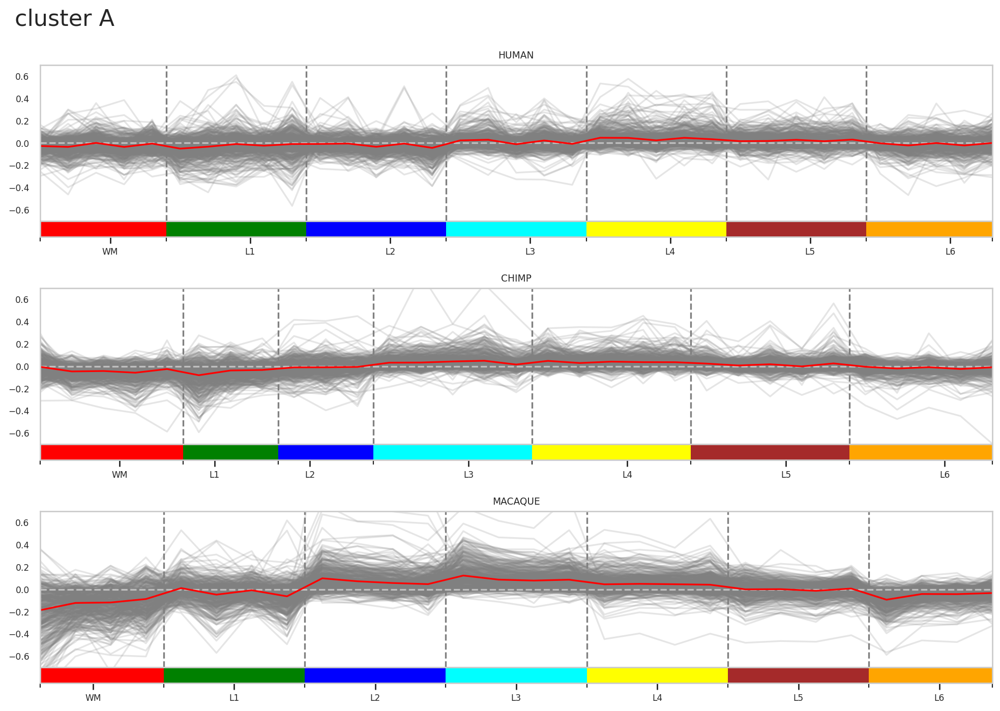

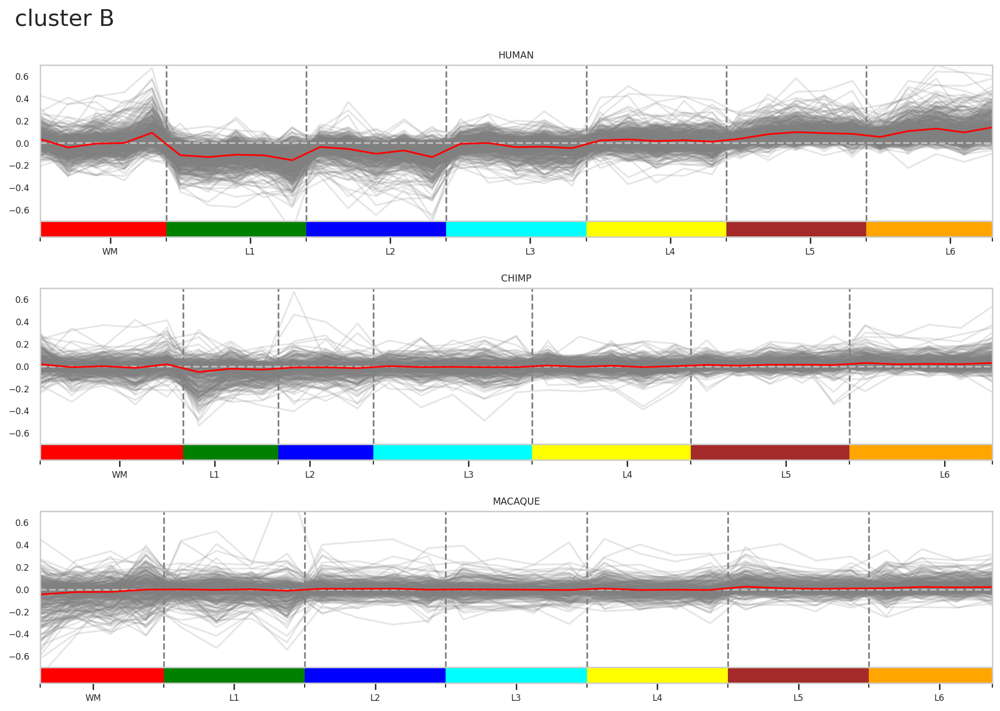

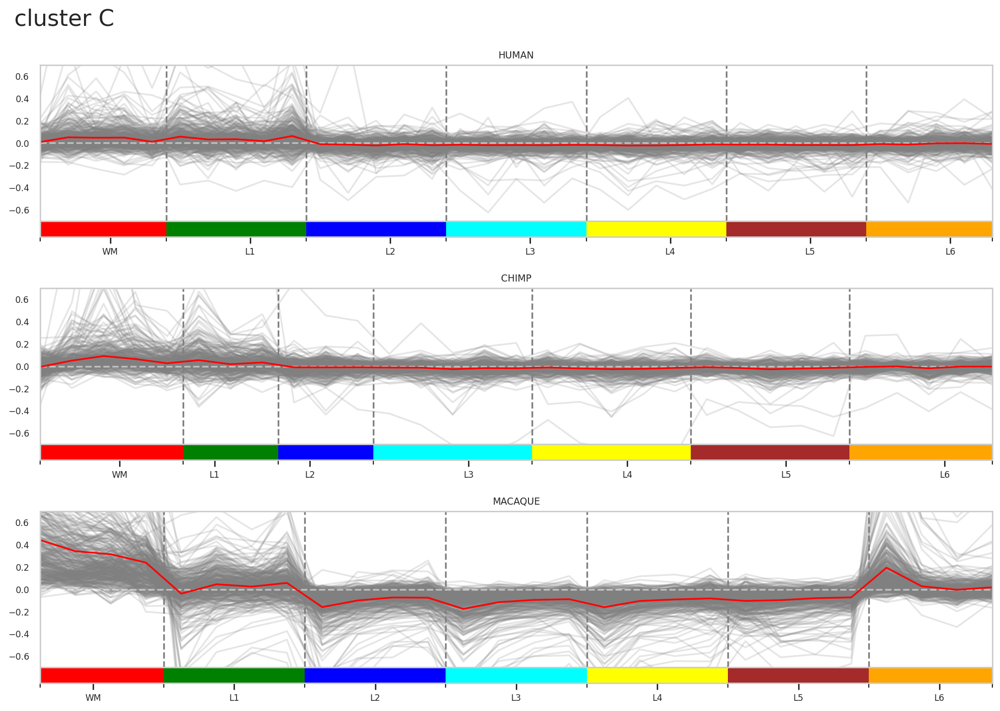

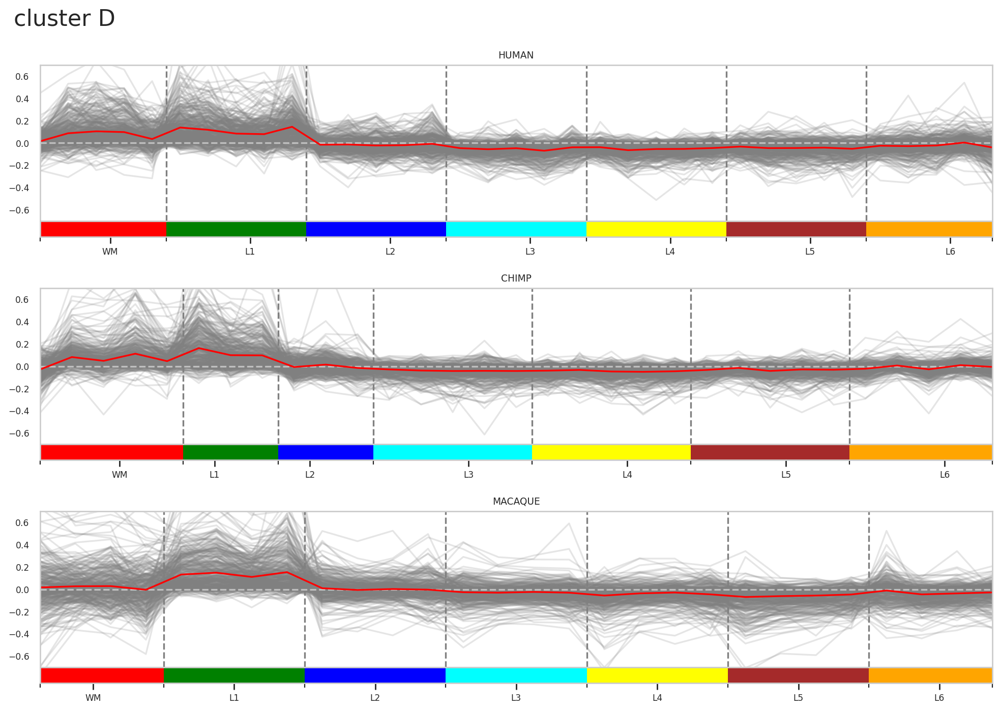

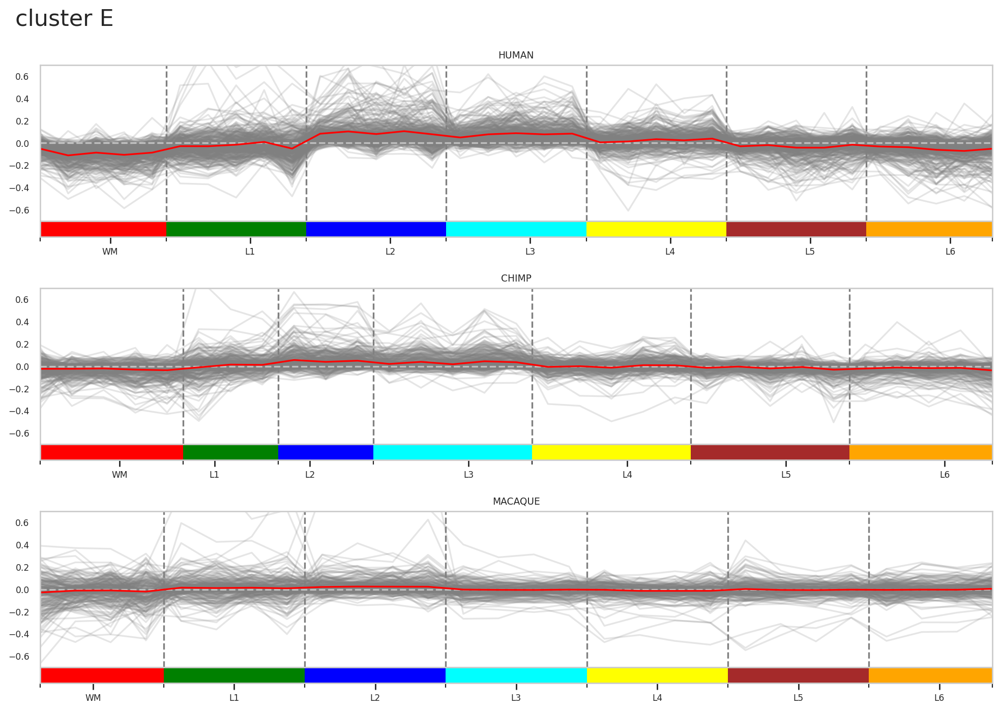

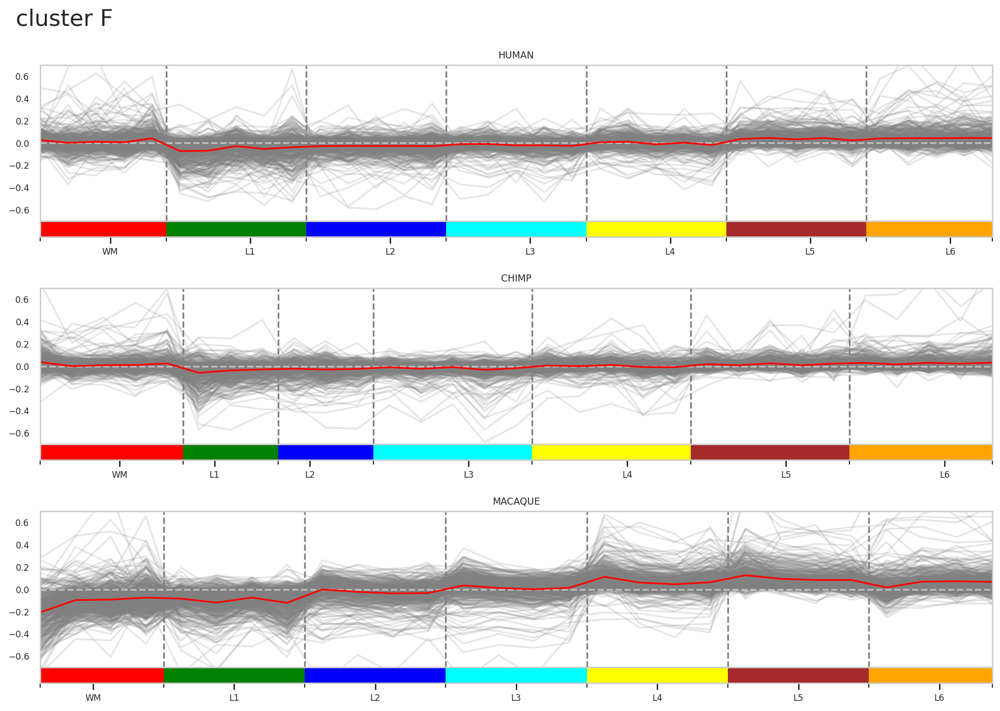

In [44]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker
sns.set_style("whitegrid")

for label in ['A', 'B', 'C', 'D', 'E', 'F']:
    genes = labels[labels == label].index.tolist()

    fig, axes = plt.subplots(3, 1, figsize=(15, 10), gridspec_kw={'hspace': 0.3})
    fig.suptitle(f'cluster {label}', fontsize=20, x=0.2)

    for ax, cond in zip(axes, ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = df_hs.loc[sample_order[cond], genes]
        # count number of samples for each layer
        lines = [sum(map(lambda x: layer in x, sample_order[cond])) for layer in layers]
        # position for layer boarders
        layer_pos = np.cumsum(lines) - 1
        # min and max values
        ymin, ymax = df_snake.min().min() + 0.1, df_snake.max().max() + 0.1
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(np.arange(len(sample_mean)), df_snake, '-', color='grey', alpha=0.2)
        ax.vlines(layer_pos + 0.5, ymin=-0.7, ymax=ymax, colors='grey', linestyles='dashed')
        ax.hlines(0, xmin=0, xmax=len(sample_mean) - 1, colors='white', linestyles='dashed', alpha=0.5)
        ax.plot(np.arange(len(sample_mean)), sample_mean, 'red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, len(sample_mean) - 1)
        ax.set_ylim(-0.7, 0.7)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(['red', 'green', 'blue', 'cyan', 'yellow', 'brown', 'orange'])

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos - 1.5))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    plt.savefig(f'sample_data/snakeplots/snakeplot_samples_cluster{label}.png', bbox_inches='tight')
    plt.savefig(f'sample_data/snakeplots/snakeplot_samples_cluster{label}.pdf', bbox_inches='tight')

In [45]:
df_hs_annotatin = df_hs.copy()
df_hs_annotatin['layer'] = adata_norm_anova.obs.layer
df_hs_annotatin['condition'] = adata_norm_anova.obs.condition
df_hs_annotatin.head()

,VXN,XKR4,DOCK9,UST,MSI2,NPAS3,NGB,TMEM121,TSFM,HS3ST4,...,RNF34,ROCK2,PLEKHA1,PLPP7,PPP4C,PRKCI,PRPF6,PRRT3,layer,condition
WM.human_759,-0.001253,0.137043,-0.035623,-0.010431,0.058308,-0.019822,0.073025,0.079386,-0.003300,0.280137,...,-0.037329,0.052382,0.059215,0.040246,-0.079488,-0.080315,-0.099355,0.000176,WM,human
WM.human_j12,-0.001793,0.024949,-0.103842,0.007911,0.242536,0.121932,-0.050084,0.000220,-0.015823,0.408712,...,-0.082624,0.071425,-0.123298,-0.003794,-0.033311,-0.028559,-0.030729,-0.009404,WM,human
WM.human_j3,-0.004376,0.138618,-0.078281,-0.012923,0.246503,0.234896,0.017447,-0.058111,0.009647,0.302142,...,-0.040386,0.138369,-0.015067,0.012875,-0.071688,-0.048165,-0.066218,0.031004,WM,human
WM.human_j4,-0.001413,-0.010746,-0.161150,-0.038087,0.093969,0.149936,0.036529,-0.056292,-0.008251,0.271307,...,-0.025527,0.142840,-0.001496,-0.009317,-0.096247,-0.058913,-0.024563,-0.038509,WM,human
WM.human_j6,-0.000987,0.240905,-0.017398,-0.167016,0.022730,0.131422,0.057162,0.027936,0.018600,0.579966,...,-0.127856,0.024023,-0.020245,-0.009196,-0.116996,-0.051158,-0.072915,0.001779,WM,human


In [46]:
layer_mean = df_hs_annotatin.groupby(['condition', 'layer']).mean()
layer_mean

VXN      XKR4     DOCK9       UST      MSI2     NPAS3  \
condition layer                                                               
chimp     L1    -0.018506 -0.002481  0.049604 -0.002655  0.019377 -0.002532   
          L2     0.008264 -0.002481 -0.039886 -0.002655 -0.004326 -0.002532   
          L3     0.000698  0.000995 -0.019665  0.004388 -0.004106 -0.003876   
          L4    -0.003054 -0.000876  0.002839 -0.003115 -0.000635 -0.003857   
          L5    -0.006649  0.000239 -0.011863 -0.001465 -0.005151  0.004908   
          L6     0.006140  0.001404 -0.001799  0.000966  0.001038 -0.002341   
          WM     0.009010  0.001214  0.024658  0.002412 -0.000177  0.008203   
human     L1    -0.003134 -0.229345 -0.157537 -0.163089  0.247059  0.257637   
          L2     0.003556 -0.127235 -0.005260 -0.095989 -0.053191 -0.072682   
          L3     0.000160 -0.118020  0.085553  0.058899 -0.106948 -0.173896   
          L4    -0.000177  0.025443  0.057891  0.142839 -0.077471 -0.097124   
          L5    -0.000338  0.163832  0.000558  0.096430 -0.077393 -0.039646   
          L6     0.001897  0.179172  0.098053  0.005019 -0.064864  0.002038   
          WM    -0.001964  0.106154 -0.079259 -0.044109  0.132809  0.123673   
macaque   L1    -0.242721  0.005507  0.058929 -0.005291  0.006679  0.005162   
          L2     0.208455  0.002482 -0.011001 -0.001815 -0.003886 -0.001236   
          L3     0.133632 -0.002568 -0.014358 -0.002826 -0.001757 -0.001112   
          L4     0.198879 -0.000154 -0.021988 -0.000067 -0.002155 -0.003559   
          L5     0.035125 -0.002499  0.000525  0.001381  0.001657  0.002432   
          L6    -0.012689 -0.003373 -0.002501  0.001072  0.000346  0.002601   
          WM    -0.320681  0.000604 -0.009606  0.007546 -0.000884 -0.004288   

                      NGB   TMEM121      TSFM    HS3ST4  ...   RHOBTB1  \
condition layer                                          ...             
chimp     L1    -0.016057 -0.003923 -0.093951 -0.002323  ... -0.008356   
          L2    -0.005200  0.004174  0.019601 -0.002323  ... -0.000192   
          L3     0.006714  0.001520  0.019114 -0.001809  ...  0.004277   
          L4     0.003454  0.002147  0.013425 -0.002488  ... -0.005916   
          L5     0.000379  0.000682  0.022966  0.002295  ... -0.005622   
          L6     0.013506 -0.002820 -0.020756  0.002331  ...  0.002164   
          WM    -0.011298 -0.001679  0.009860  0.002459  ...  0.010226   
human     L1    -0.181042 -0.090247 -0.013067 -0.304980  ... -0.016186   
          L2    -0.131135 -0.001089 -0.000039 -0.336817  ...  0.043935   
          L3     0.092335  0.006554 -0.003690 -0.295009  ...  0.044009   
          L4    -0.009170  0.026464 -0.000483 -0.073837  ...  0.015722   
          L5     0.000929  0.032696  0.001442  0.221288  ... -0.015181   
          L6     0.201268  0.026996  0.015663  0.420903  ... -0.011326   
          WM     0.026816 -0.001372  0.000175  0.368453  ... -0.060973   
macaque   L1     0.002366 -0.002299 -0.085380 -0.001829  ...  0.005153   
          L2    -0.003584  0.001809  0.021471 -0.000855  ...  0.017951   
          L3     0.000740  0.000098  0.068174 -0.001829  ...  0.009559   
          L4     0.000490  0.001319  0.029294  0.000347  ...  0.013217   
          L5     0.001741  0.001253  0.065056  0.001724  ... -0.022680   
          L6    -0.002273  0.000119 -0.001767  0.004271  ... -0.033729   
          WM     0.000520 -0.002299 -0.096848 -0.001829  ...  0.010528   

                    RHPN1     RNF34     ROCK2   PLEKHA1     PLPP7     PPP4C  \
condition layer                                                               
chimp     L1     0.087088 -0.035470 -0.005492 -0.053774  0.009915 -0.039813   
          L2     0.018696 -0.086677  0.009322 -0.045845  0.052399 -0.025152   
          L3    -0.055368 -0.039986 -0.054134 -0.022546  0.004133  0.008351   
          L4    -0.060823  0.008785 -0.068367  0.030084  0.001331  0.005529   
          L5    -0.065243  

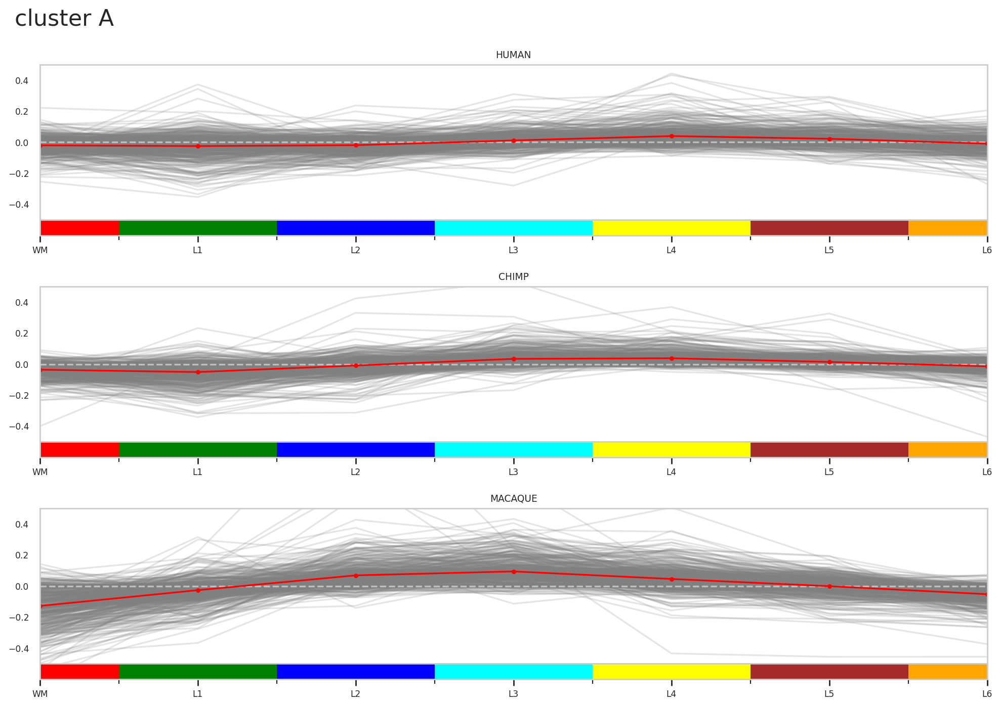

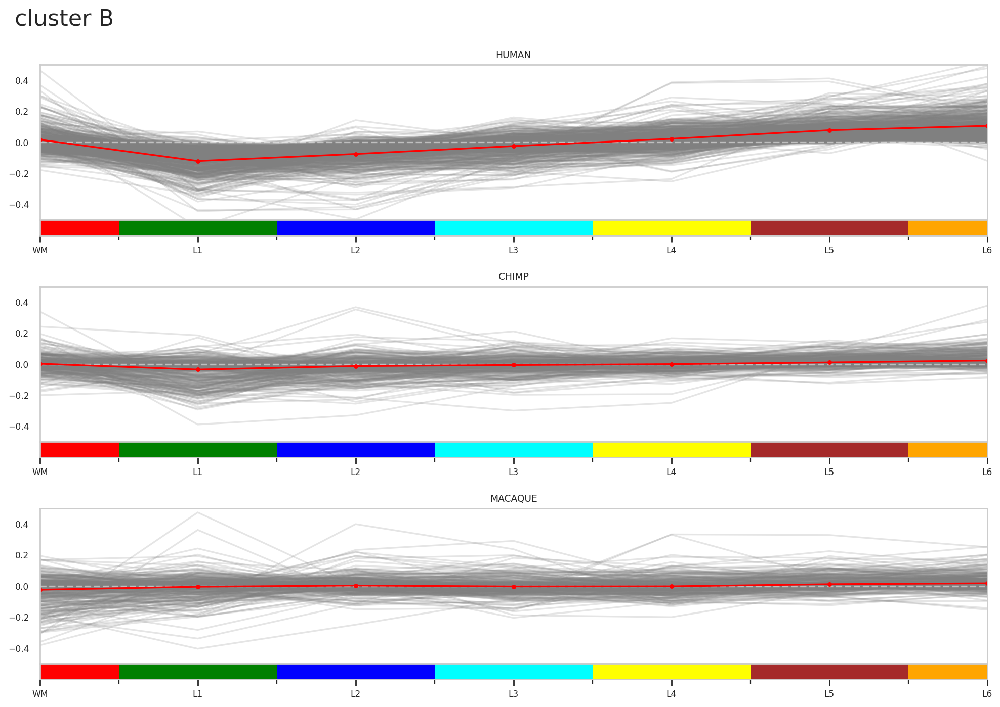

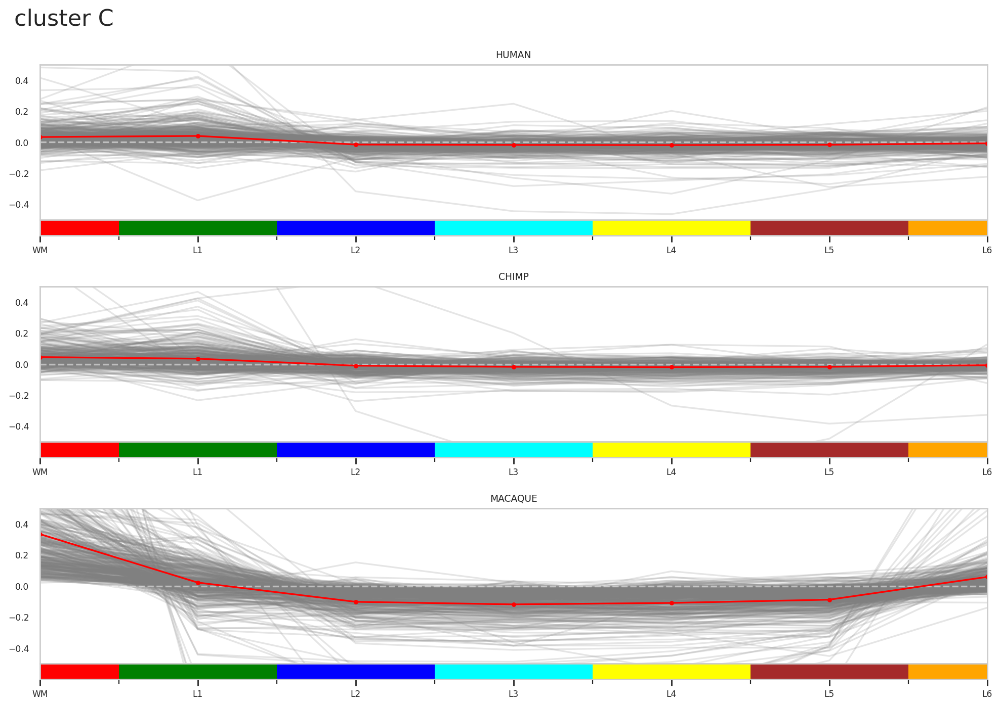

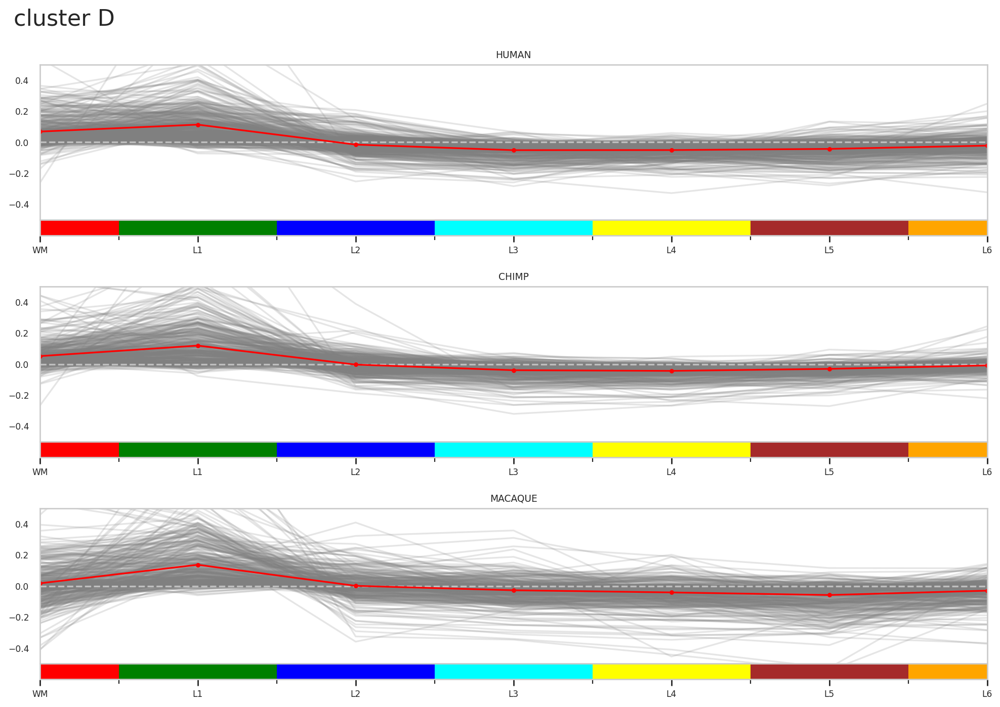

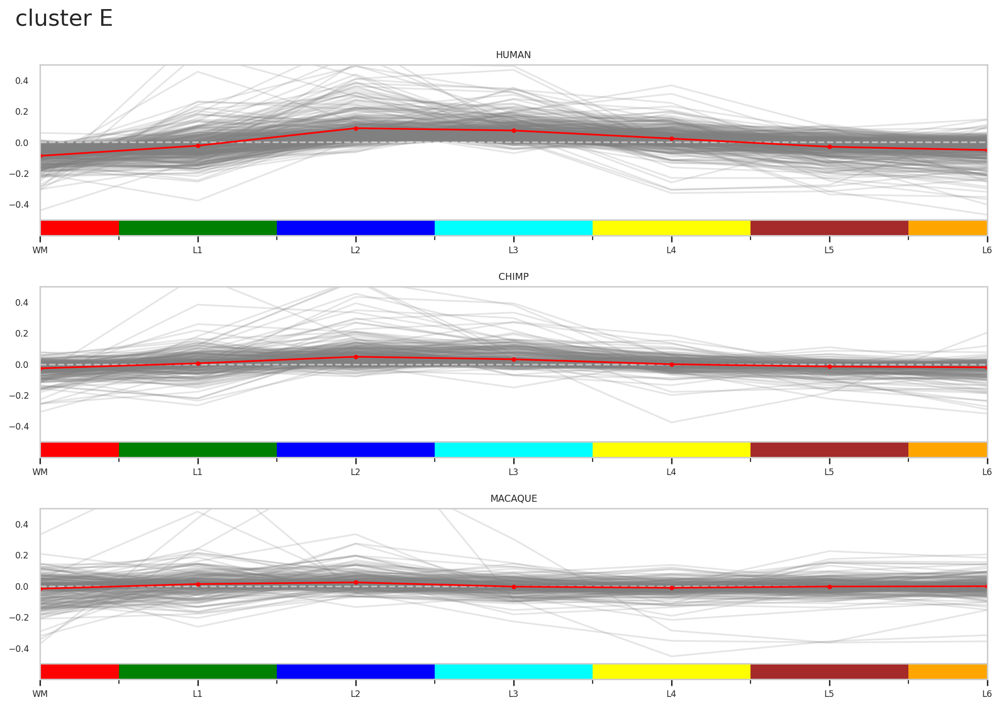

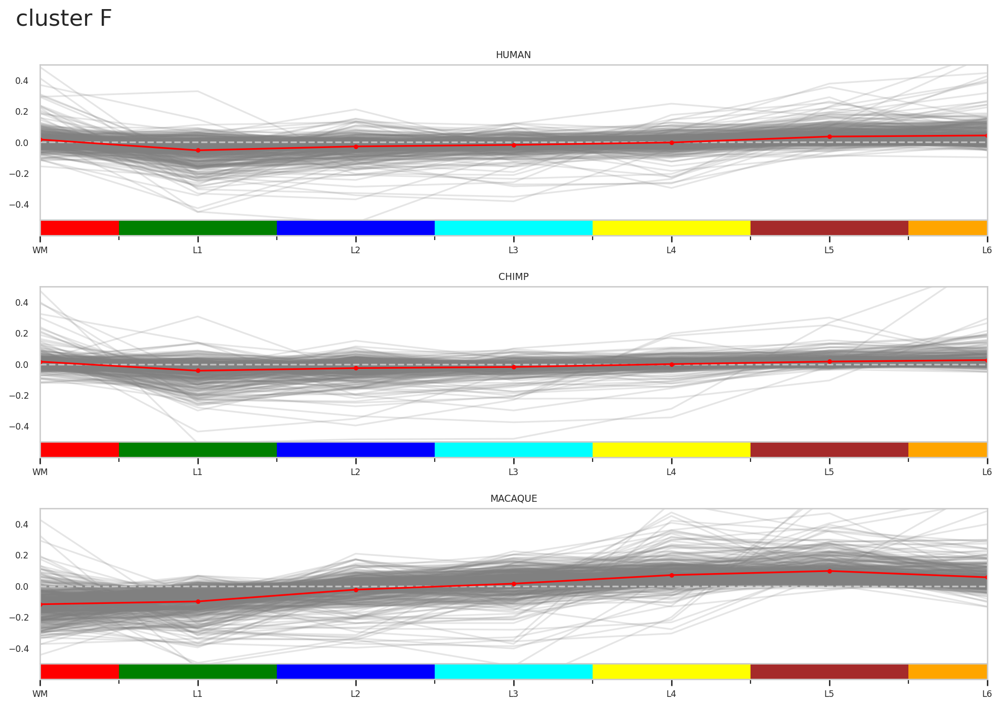

In [47]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

for label in ['A', 'B', 'C', 'D', 'E', 'F']:
    genes = labels[labels == label].index.tolist()

    fig, axes = plt.subplots(3, 1, figsize=(15, 10), gridspec_kw={'hspace': 0.3})
    fig.suptitle(f'cluster {label}', fontsize=20, x=0.2)

    for ax, cond in zip(axes, ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = layer_mean.loc[cond, genes].loc[layers]
        # position for layers
        layer_pos = np.arange(7)
        # min and max values
        ymin, ymax = df_snake.min().min() + 0.1, df_snake.max().max() + 0.1
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(layer_pos, df_snake, '-', color='grey', alpha=0.2)
        ax.hlines(0, xmin=0, xmax=6, colors='white', linestyles='dashed', alpha=0.5)
        ax.plot(layer_pos, sample_mean, '.-', color='red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, 6)
        ax.set_ylim(-0.5, 0.5)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(['red', 'green', 'blue', 'cyan', 'yellow', 'brown', 'orange'])

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    plt.savefig(f'sample_data/snakeplots/snakeplot_layers_cluster{label}.png', bbox_inches='tight')
    plt.savefig(f'sample_data/snakeplots/snakeplot_layers_cluster{label}.pdf', bbox_inches='tight')

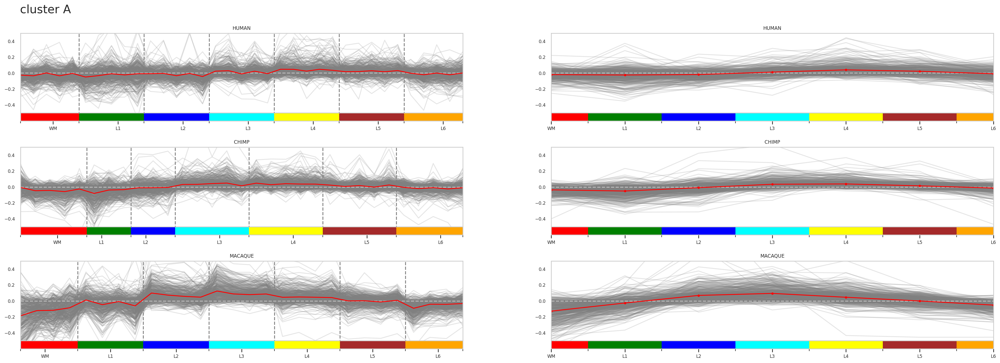

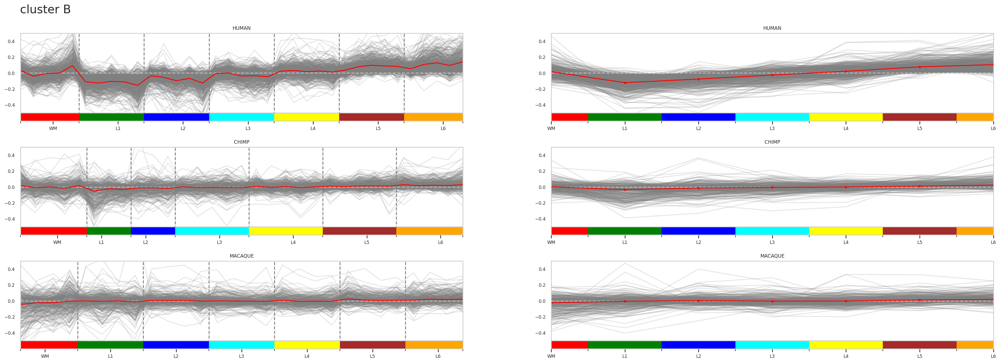

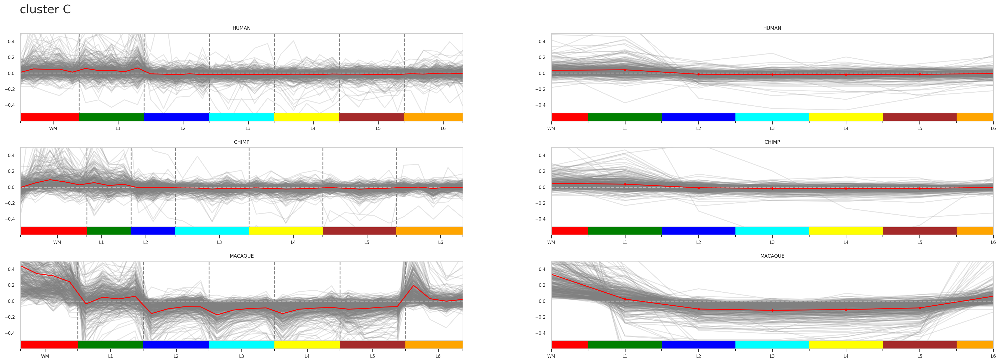

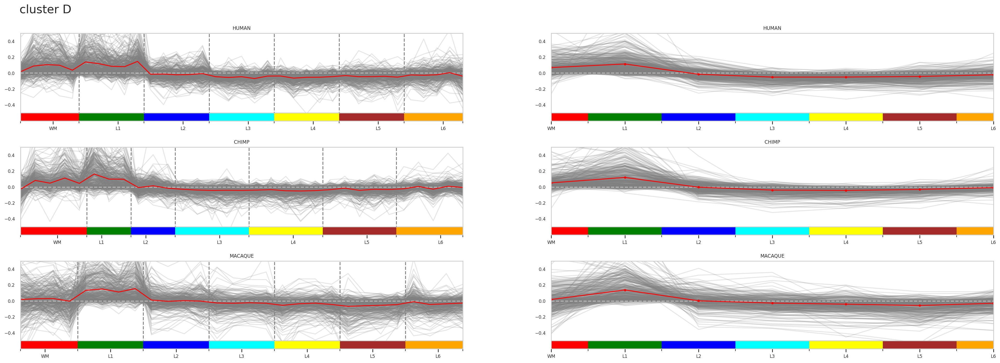

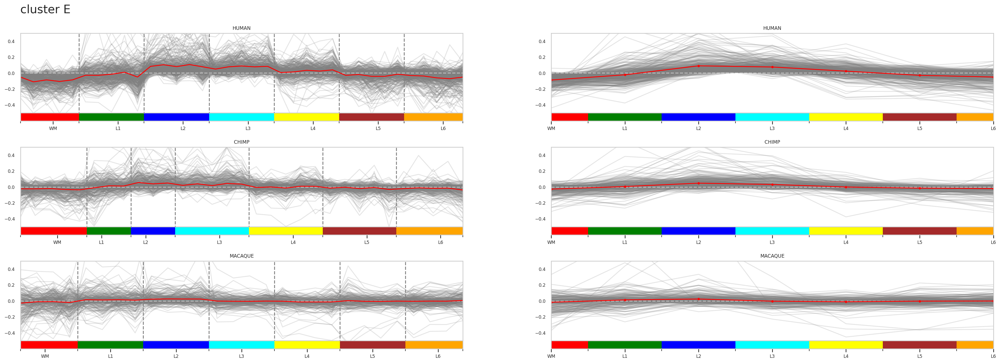

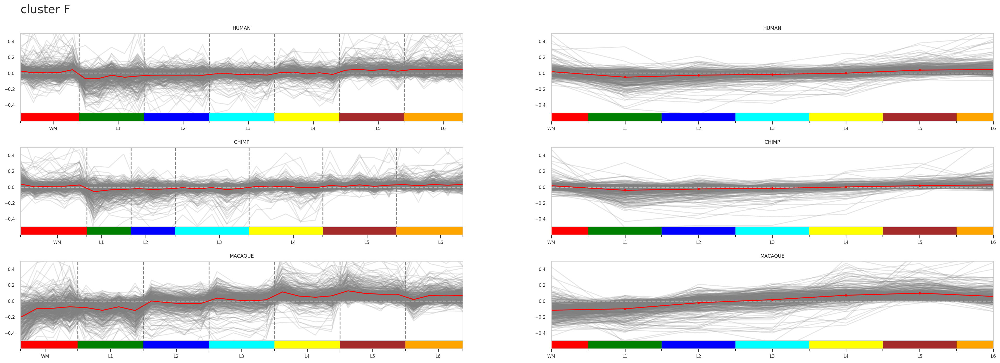

In [48]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import ticker

for label in ['A', 'B', 'C', 'D', 'E', 'F']:
    genes = labels[labels == label].index.tolist()

    fig, axes = plt.subplots(3, 2, figsize=(30, 10), gridspec_kw={'hspace': 0.3})
    fig.suptitle(f'cluster {label}', fontsize=20, x=0.2)

    for ax, cond in zip(axes[:, 0], ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = df_hs.loc[sample_order[cond], genes]
        # count number of samples for each layer
        lines = [sum(map(lambda x: layer in x, sample_order[cond])) for layer in layers]
        # position for layer boarders
        layer_pos = np.cumsum(lines) - 1
        # min and max values
        ymin, ymax = df_snake.min().min() + 0.1, df_snake.max().max() + 0.1
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(np.arange(len(sample_mean)), df_snake, '-', color='grey', alpha=0.2)
        ax.vlines(layer_pos + 0.5, ymin=-0.7, ymax=ymax, colors='grey', linestyles='dashed')
        ax.hlines(0, xmin=0, xmax=len(sample_mean) - 1, colors='white', linestyles='dashed', alpha=0.5)
        ax.plot(np.arange(len(sample_mean)), sample_mean, 'red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, len(sample_mean) - 1)
        ax.set_ylim(-0.5, 0.5)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(['red', 'green', 'blue', 'cyan', 'yellow', 'brown', 'orange'])

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos - 1.5))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))

    for ax, cond in zip(axes[:, 1], ['human', 'chimp', 'macaque']):
        # subset df
        df_snake = layer_mean.loc[cond, genes].loc[layers]
        # position for layers
        layer_pos = np.arange(7)
        # min and max values
        ymin, ymax = df_snake.min().min() + 0.1, df_snake.max().max() + 0.1
        # sample mean
        sample_mean = df_snake.mean(axis=1)
        # ploting
        ax.plot(layer_pos, df_snake, '-', color='grey', alpha=0.2)
        ax.hlines(0, xmin=0, xmax=6, colors='white', linestyles='dashed', alpha=0.5)
        ax.plot(layer_pos, sample_mean, '.-', color='red')
        # customize
        ax.grid(False)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(cond.upper())
        ax.set_xlim(0, 6)
        ax.set_ylim(-0.5, 0.5)
        # create colorbar
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('bottom', size='10%', pad=0)
        cmap = mpl.colors.ListedColormap(['red', 'green', 'blue', 'cyan', 'yellow', 'brown', 'orange'])

        bounds = [0] + list(layer_pos + 0.5)
        bounds[-1] = bounds[-1] - 0.5
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        fig.colorbar(
            mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
            cax=cax,
            ticks=bounds,
            orientation='horizontal',
            spacing='proportional'
        )
        cax.xaxis.set_major_locator(ticker.FixedLocator(layer_pos))
        cax.xaxis.set_major_formatter(ticker.FixedFormatter(layers))
    plt.savefig(f'sample_data/snakeplots/snakeplot_samples_layers_cluster{label}.png', bbox_inches='tight')
    plt.savefig(f'sample_data/snakeplots/snakeplot_samples_layers_cluster{label}.pdf', bbox_inches='tight')

In [49]:
labels.to_csv('genes_clusters.csv')

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


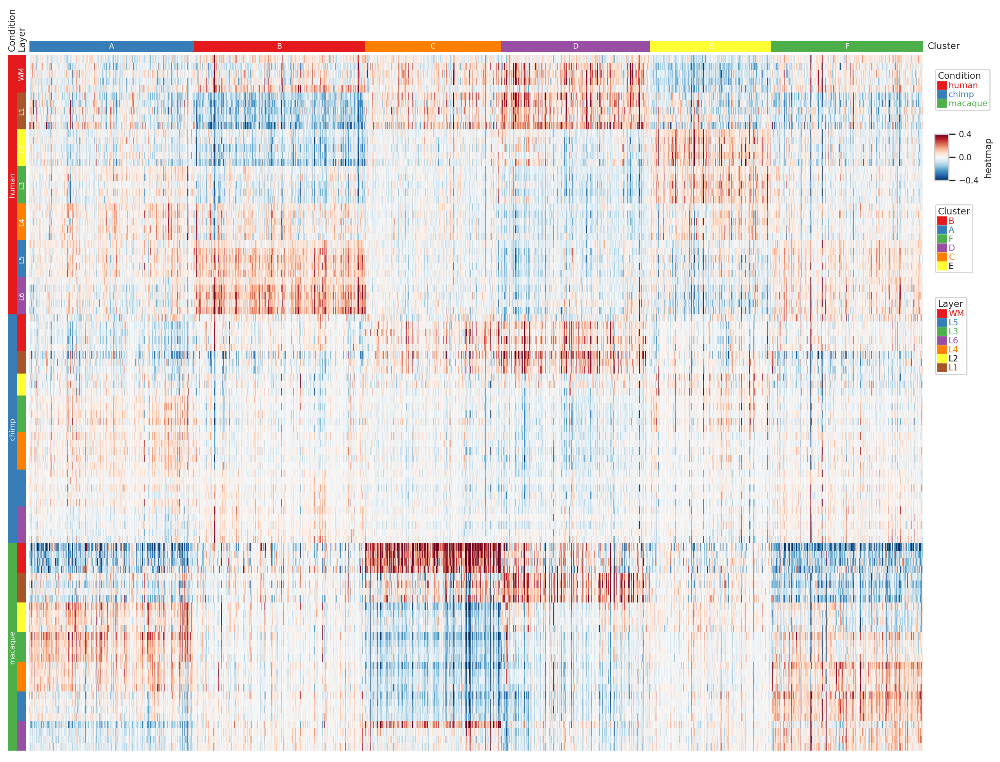

In [50]:
import PyComplexHeatmap as hm
from matplotlib.colors import LinearSegmentedColormap

col_ha = hm.HeatmapAnnotation(Cluster=hm.anno_simple(labels.sort_values().astype(str), legend=True, add_text=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(15, 10))
cm = hm.ClusterMapPlotter(data=df_hs.loc[sample_order['all'], order], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False, row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=0.4, vmin=-0.4)
#legend_pad control the space between heatmap and legend.
plt.savefig("sample_data/heatmaps/heatmap_spectr_hs_ann.png", bbox_inches='tight')
plt.savefig("sample_data/heatmaps/heatmap_spectr_hs_ann.pdf", bbox_inches='tight')
plt.show()

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


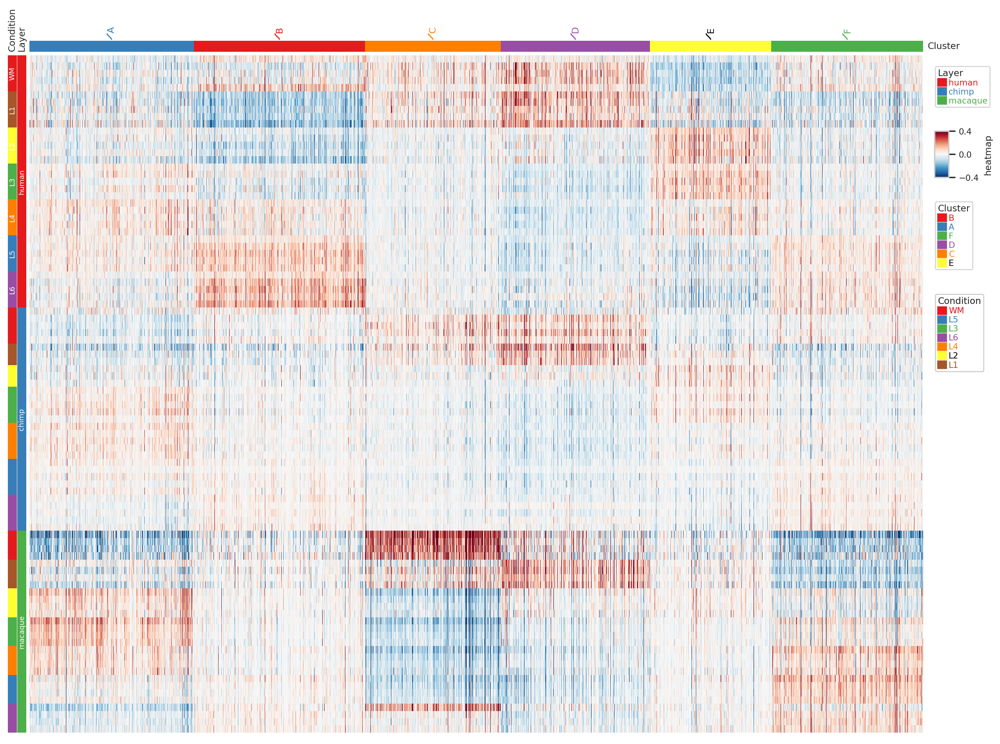

In [51]:
col_ha = hm.HeatmapAnnotation(label=hm.anno_label(labels.sort_values().astype(str), merge=True, rotation=90),
                              Cluster=hm.anno_simple(labels.sort_values().astype(str), legend=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(15, 10))
cm = hm.ClusterMapPlotter(data=df_hs.loc[sample_order['all'], order], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False,row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=0.4, vmin=-0.4)
#legend_pad control the space between heatmap and legend.
plt.savefig("sample_data/heatmaps/heatmap_spectr_hs_layers_ann.png", bbox_inches='tight')
plt.show()

Посмтроим отдельную хитмапу для каждого слоя

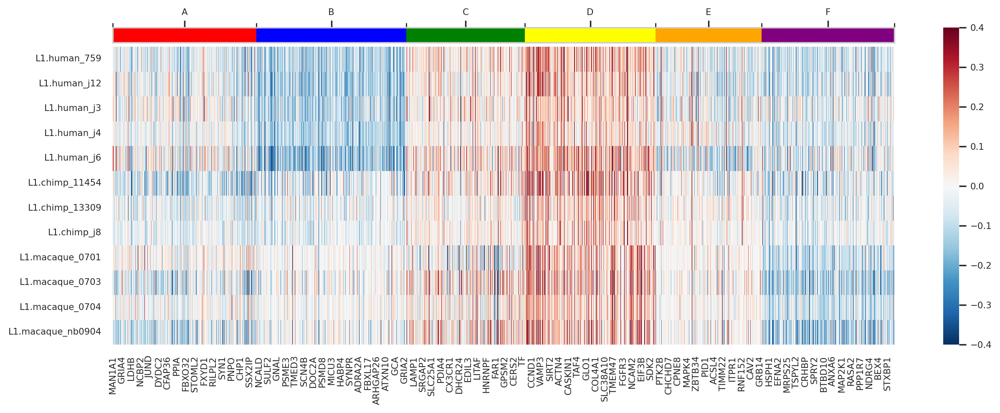

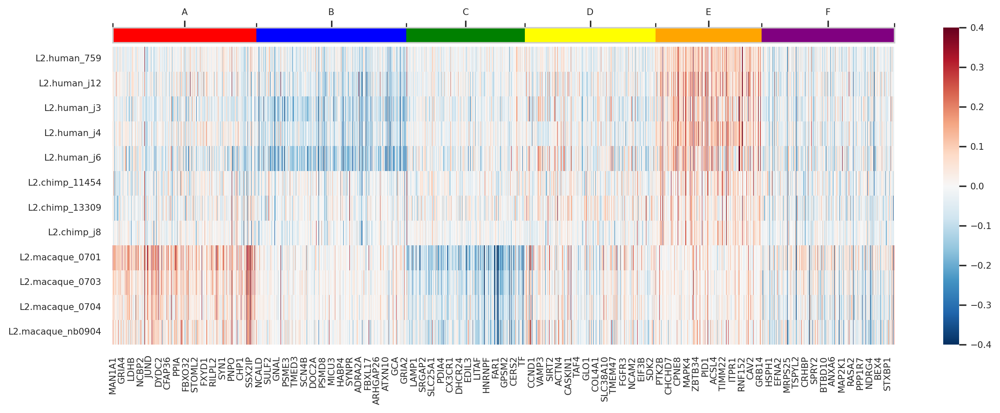

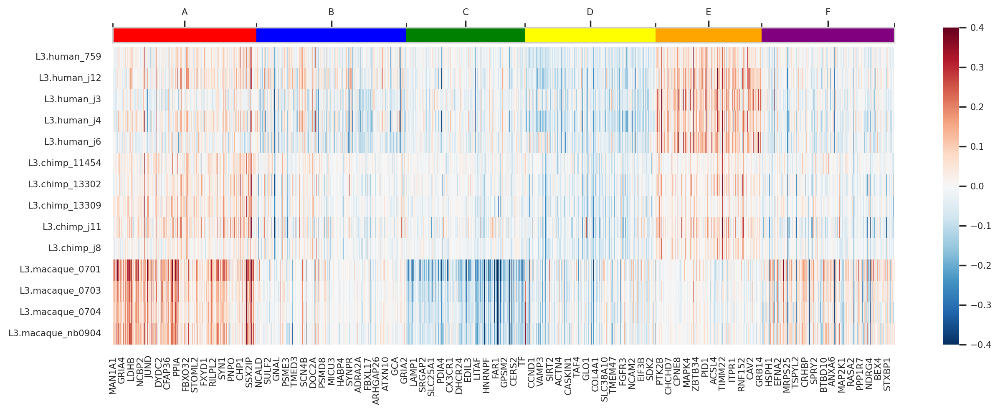

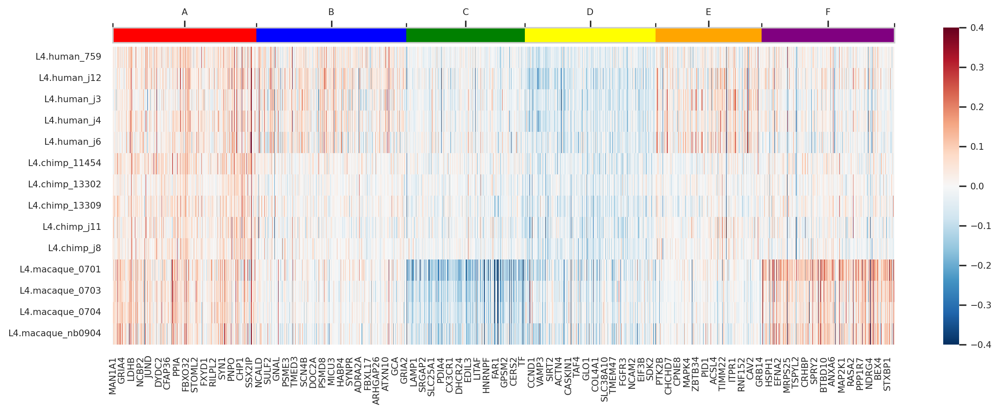

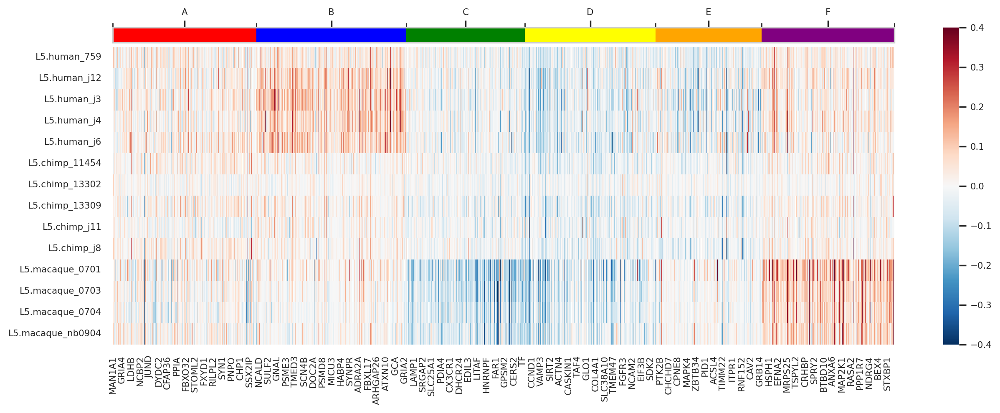

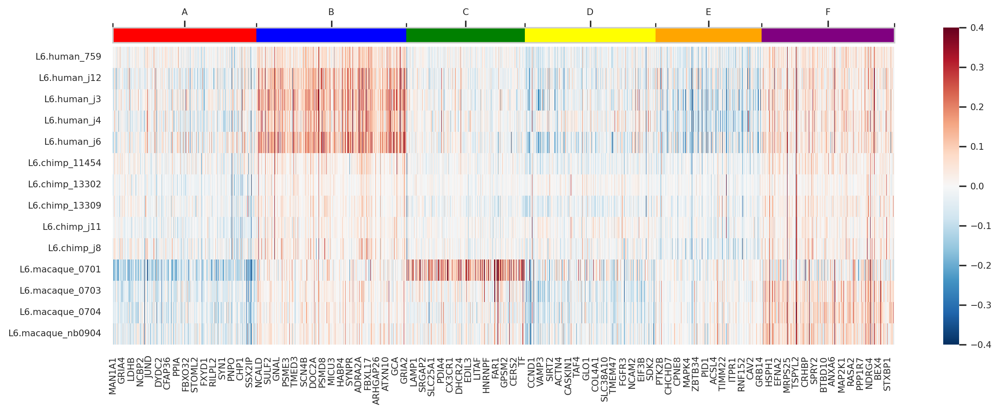

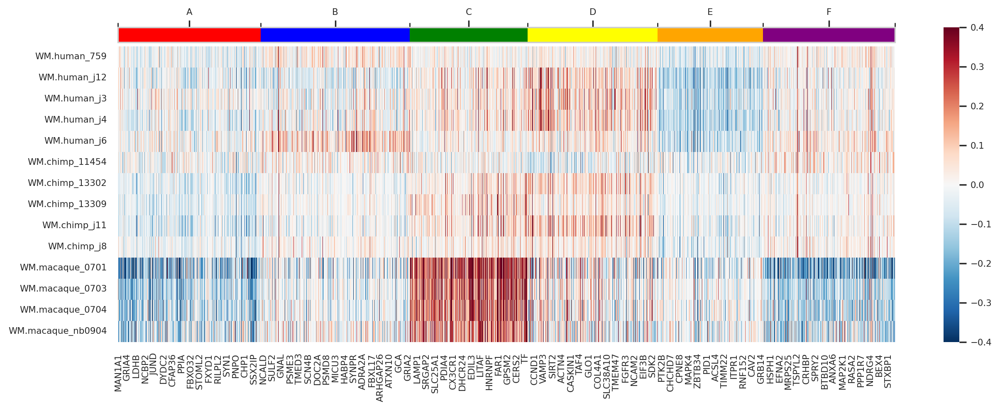

In [52]:
from matplotlib.patches import bbox_artist

for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    fig, ax = plt.subplots(figsize=(15, 5), gridspec_kw={'hspace': 0})
    df_layer = df_hs.loc[df_hs.index.str.contains(layer)]
    sns.heatmap(df_layer.loc[:, order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)
    # colorbar
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('top', size='5%', pad=0.05)
    cmap = mpl.colors.ListedColormap(['red', 'blue', 'green',  'yellow', 'orange', 'purple'])

    cluster_size = labels.value_counts().loc[clusters].values
    cluster_pos = cluster_size.cumsum()
    bounds = [0] + list(cluster_pos)
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ticks=bounds,
        orientation='horizontal',
        spacing='proportional'
    )
    cax.xaxis.set_major_locator(ticker.FixedLocator(cluster_pos - cluster_size / 2))
    cax.xaxis.set_major_formatter(ticker.FixedFormatter(clusters))
    cax.xaxis.tick_top() 
    plt.savefig(f'sample_data/heatmaps/heatmap_norm_hs_{layer}.png', bbox_inches='tight')

Построим хитмапу генов которые значимо отличаются в двух видах

In [53]:
human_specific_genes_both = anova_sig_genes[anova_sig_genes['count'] == 2].index.unique().tolist()
df_hsb = df[human_specific_genes_both].copy()
df_hsb.head()

,VXN,XKR4,DOCK9,UST,MSI2,NPAS3,NGB,TMEM121,TSFM,HS3ST4,...,KREMEN1,MRPL34,STAG1,SOX11,MEX3A,NEU4,NDUFA2,MAFB,SLC44A5,FAT4
WM.human_759,-0.001253,0.137043,-0.035623,-0.010431,0.058308,-0.019822,0.073025,0.079386,-0.003300,0.280137,...,-0.076584,-0.057430,-0.037806,-0.124204,-0.064450,0.030112,0.018632,-0.093569,-0.096566,-0.117441
WM.human_j12,-0.001793,0.024949,-0.103842,0.007911,0.242536,0.121932,-0.050084,0.000220,-0.015823,0.408712,...,-0.061216,-0.053634,-0.015748,-0.290239,-0.123198,0.066291,0.062664,-0.287717,-0.130880,-0.152360
WM.human_j3,-0.004376,0.138618,-0.078281,-0.012923,0.246503,0.234896,0.017447,-0.058111,0.009647,0.302142,...,-0.068803,-0.029379,0.010615,-0.084311,-0.105430,-0.003974,0.014352,-0.140538,-0.180487,-0.178477
WM.human_j4,-0.001413,-0.010746,-0.161150,-0.038087,0.093969,0.149936,0.036529,-0.056292,-0.008251,0.271307,...,-0.037727,-0.111337,-0.005236,-0.189415,-0.134812,0.059453,0.017989,-0.225796,-0.192107,-0.125051
WM.human_j6,-0.000987,0.240905,-0.017398,-0.167016,0.022730,0.131422,0.057162,0.027936,0.018600,0.579966,...,-0.066581,-0.059801,-0.030717,-0.224289,-0.121880,0.018797,0.023481,-0.134205,-0.164806,-0.203305


In [54]:
labels_hsb = labels.loc[human_specific_genes_both]
order_hsb = labels_hsb.sort_values().index

Starting plotting..
Starting calculating row orders..
Reordering rows..
Starting calculating col orders..
Reordering cols..
Plotting matrix..
Starting plotting HeatmapAnnotations
Starting plotting HeatmapAnnotations
Plotting legends..


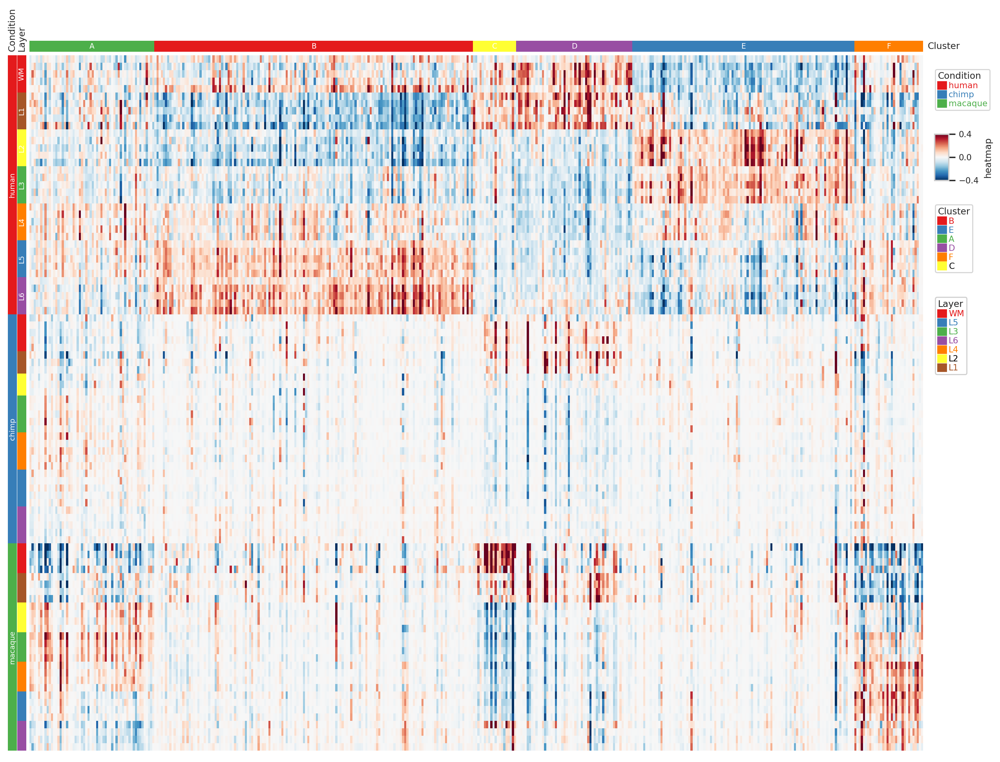

In [55]:
import PyComplexHeatmap as hm
from matplotlib.colors import LinearSegmentedColormap

col_ha = hm.HeatmapAnnotation(Cluster=hm.anno_simple(labels_hsb.sort_values().astype(str), legend=True, add_text=True), axis=1)

row_ha = hm.HeatmapAnnotation(Condition=hm.anno_simple(adata_norm_anova.obs.condition.astype(str), legend=True, add_text=True),
                              Layer=hm.anno_simple(adata_norm_anova.obs.layer.astype(str), legend=True, add_text=True), axis=0)

plt.figure(figsize=(15, 10))
cm = hm.ClusterMapPlotter(data=df_hsb.loc[sample_order['all'], order_hsb], top_annotation=col_ha, left_annotation=row_ha,
                       show_rownames=False, show_colnames=False, row_names_side='left',
                       cmap='RdBu_r', row_cluster=False, col_cluster=False,
                       rasterized=True, legend=True, legend_anchor='ax_heatmap', vmax=0.4, vmin=-0.4)
#legend_pad control the space between heatmap and legend.
#plt.savefig("sample_data/heatmaps/heatmap_spectr_hs_ann.png", bbox_inches='tight')
#plt.savefig("sample_data/heatmaps/heatmap_spectr_hs_ann.pdf", bbox_inches='tight')
plt.show()

## Кластеризация генов которые значимо отличаются в двух видах

In [56]:
human_specific_genes_both = anova_sig_genes[anova_sig_genes['count'] == 2].index.unique().tolist()

In [57]:
df_hs = df[human_specific_genes_both].copy()
df_hs.head()

,VXN,XKR4,DOCK9,UST,MSI2,NPAS3,NGB,TMEM121,TSFM,HS3ST4,...,KREMEN1,MRPL34,STAG1,SOX11,MEX3A,NEU4,NDUFA2,MAFB,SLC44A5,FAT4
WM.human_759,-0.001253,0.137043,-0.035623,-0.010431,0.058308,-0.019822,0.073025,0.079386,-0.003300,0.280137,...,-0.076584,-0.057430,-0.037806,-0.124204,-0.064450,0.030112,0.018632,-0.093569,-0.096566,-0.117441
WM.human_j12,-0.001793,0.024949,-0.103842,0.007911,0.242536,0.121932,-0.050084,0.000220,-0.015823,0.408712,...,-0.061216,-0.053634,-0.015748,-0.290239,-0.123198,0.066291,0.062664,-0.287717,-0.130880,-0.152360
WM.human_j3,-0.004376,0.138618,-0.078281,-0.012923,0.246503,0.234896,0.017447,-0.058111,0.009647,0.302142,...,-0.068803,-0.029379,0.010615,-0.084311,-0.105430,-0.003974,0.014352,-0.140538,-0.180487,-0.178477
WM.human_j4,-0.001413,-0.010746,-0.161150,-0.038087,0.093969,0.149936,0.036529,-0.056292,-0.008251,0.271307,...,-0.037727,-0.111337,-0.005236,-0.189415,-0.134812,0.059453,0.017989,-0.225796,-0.192107,-0.125051
WM.human_j6,-0.000987,0.240905,-0.017398,-0.167016,0.022730,0.131422,0.057162,0.027936,0.018600,0.579966,...,-0.066581,-0.059801,-0.030717,-0.224289,-0.121880,0.018797,0.023481,-0.134205,-0.164806,-0.203305


### Иерархическая кластеризация

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



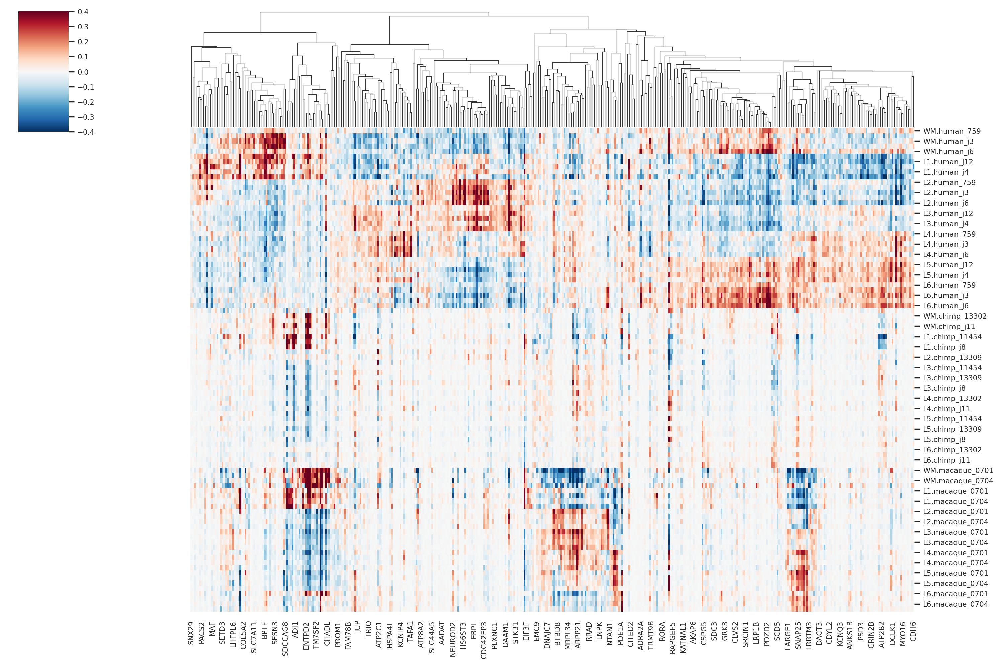

In [58]:
sns.clustermap(df_hs.loc[sample_order['all']], figsize=(15, 10), cmap="RdBu_r", metric='cosine', center=0, vmax=0.4, vmin=-0.4, annot_kws={"size": 2}, row_cluster=False).savefig('heatmap_norm_hs.png')

Сделаем кластеризацию по слоям

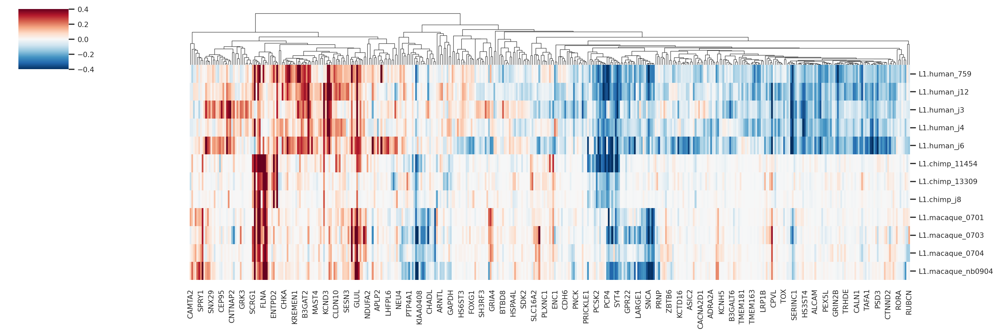

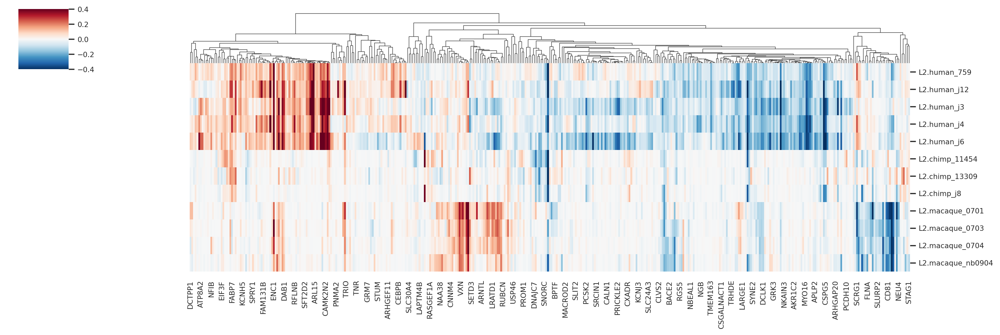

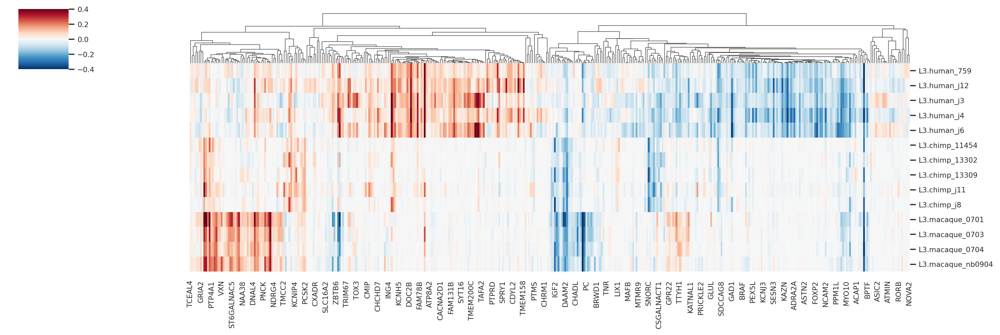

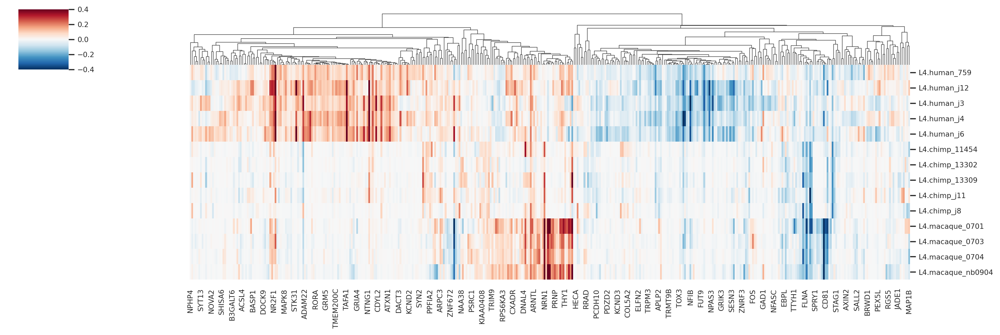

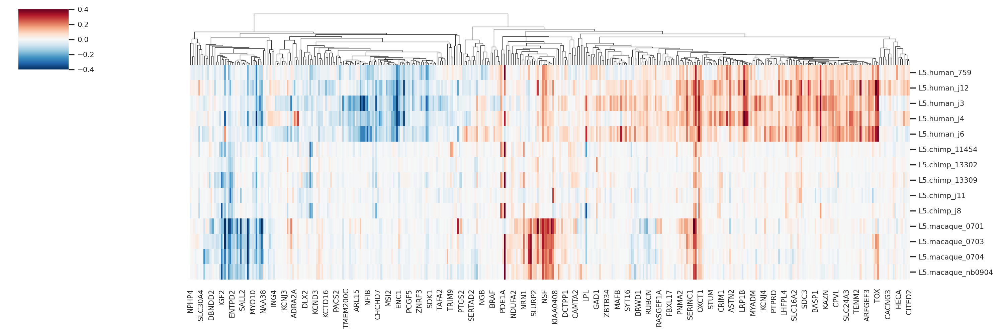

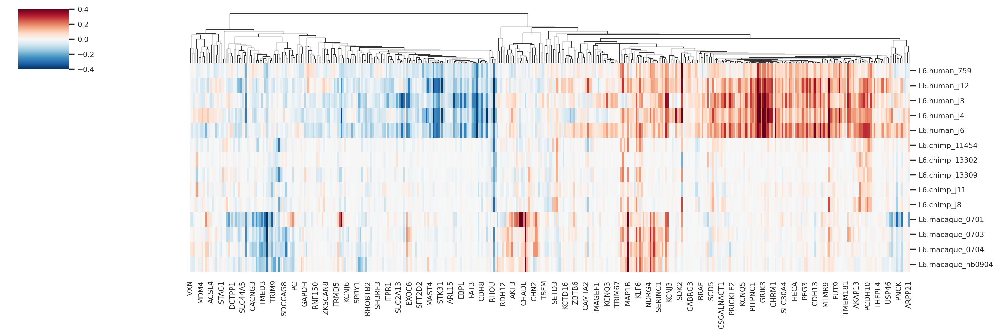

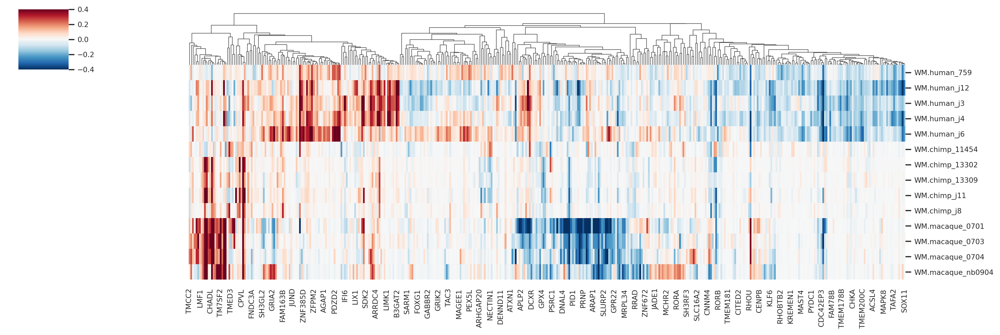

In [59]:
for layer in ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']:
    df_layer = df_hs.loc[df_hs.index.str.contains(layer)]
    sns.clustermap(df_layer, figsize=(15, 5), cmap="RdBu_r", center=0,
                   vmax=0.4, vmin=-0.4, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'heatmap_norm_hs_{layer}.png')

Сделаем кластеризацию по видам

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



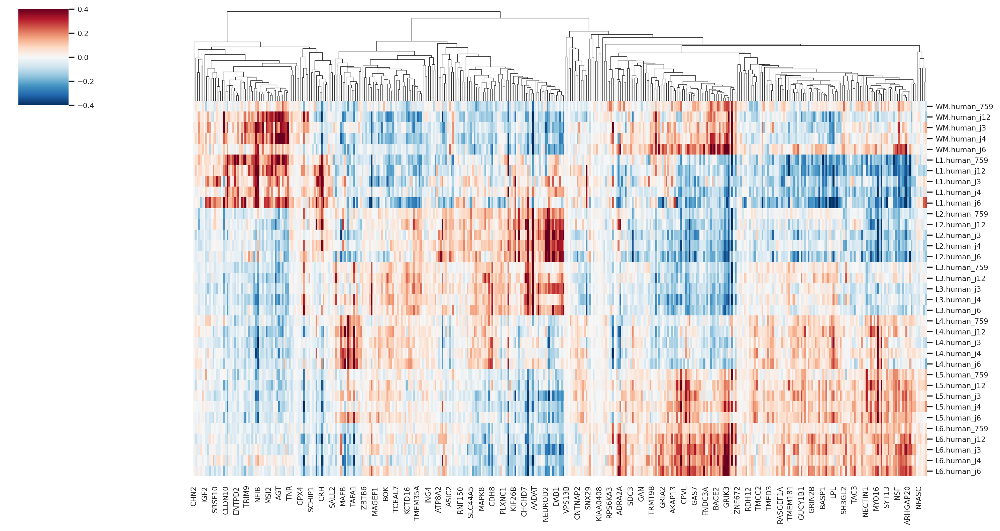

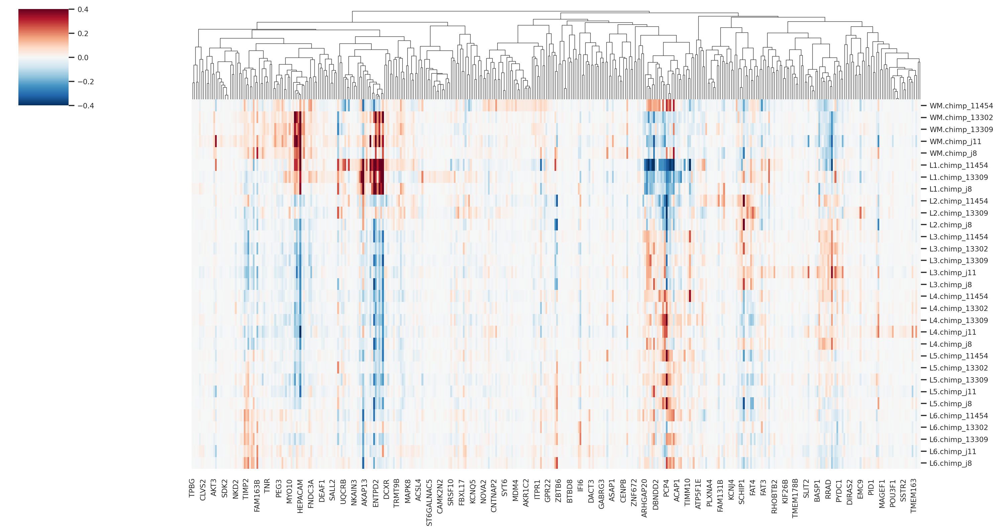

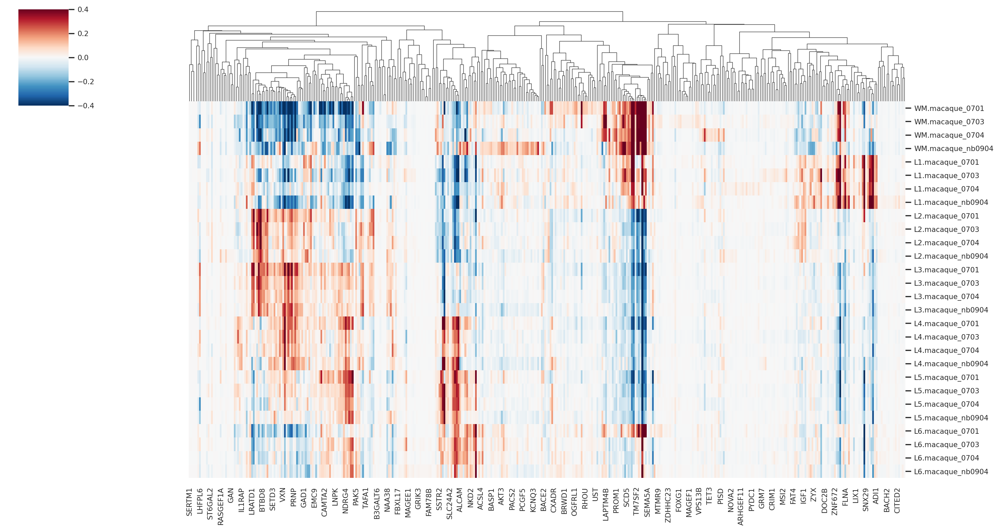

In [60]:
for cond in ['human', 'chimp', 'macaque']:
    df_cond = df_hs.loc[df_hs.index.str.contains(cond)]
    max_val = df_cond.max(axis=0).sort_values()
    df_cond = df_cond[max_val[max_val > 0].index.tolist()]
    sns.clustermap(df_cond, figsize=(15, 8), cmap="RdBu_r", center=0,
                   vmax=0.4, vmin=-0.4, metric='cosine',
                   annot_kws={"size": 2}, row_cluster=False).savefig(f'heatmap_norm_hs_{cond}.png')

### Спектральная кластеризация

In [61]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics.pairwise import pairwise_kernels
aff_matrix = pairwise_kernels(df_hs.T, metric='cosine') + 1
clustering = SpectralClustering(n_clusters=6, gamma=1, affinity='precomputed')
clustering.fit(aff_matrix)

SpectralClustering(affinity='precomputed', gamma=1, n_clusters=6)

In [62]:
labels = pd.Series(clustering.labels_, index=df_hs.columns)
order = labels.sort_values().index

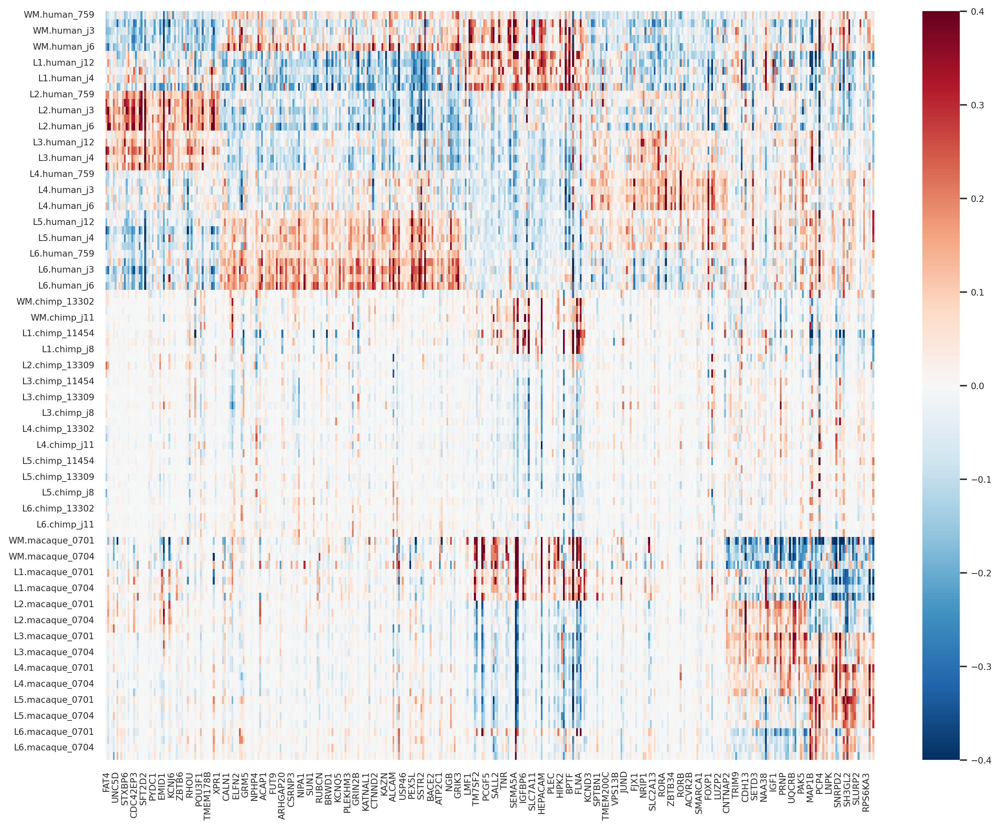

In [63]:
sns.set(font_scale=0.7)
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df_hs.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)
plt.savefig('heatmap_spectr_hs.png', bbox_inches='tight')

In [64]:
sample_mean = pd.DataFrame(index=df_hs.index, columns=df_hs.columns)

In [65]:
for label in labels.unique():
    genes = labels[labels == label].index
    for gene in genes:
        sample_mean[gene] = df_hs[genes].mean(axis=1)
sample_mean.head()

,VXN,XKR4,DOCK9,UST,MSI2,NPAS3,NGB,TMEM121,TSFM,HS3ST4,...,KREMEN1,MRPL34,STAG1,SOX11,MEX3A,NEU4,NDUFA2,MAFB,SLC44A5,FAT4
WM.human_759,-0.012527,0.058191,0.058191,-0.057282,0.005650,0.005650,0.058191,0.058191,0.039883,0.058191,...,-0.055673,-0.012527,0.005650,-0.055673,-0.055673,0.005650,-0.012527,-0.057282,-0.055673,-0.055673
WM.human_j12,-0.048683,-0.016470,-0.016470,-0.100243,0.104980,0.104980,-0.016470,-0.016470,0.041451,-0.016470,...,-0.136267,-0.048683,0.104980,-0.136267,-0.136267,0.104980,-0.048683,-0.100243,-0.136267,-0.136267
WM.human_j3,-0.008691,0.016187,0.016187,-0.037626,0.117396,0.117396,0.016187,0.016187,0.071145,0.016187,...,-0.113028,-0.008691,0.117396,-0.113028,-0.113028,0.117396,-0.008691,-0.037626,-0.113028,-0.113028
WM.human_j4,-0.033330,0.043045,0.043045,-0.079366,0.113547,0.113547,0.043045,0.043045,0.027947,0.043045,...,-0.118651,-0.033330,0.113547,-0.118651,-0.118651,0.113547,-0.033330,-0.079366,-0.118651,-0.118651
WM.human_j6,0.020157,0.131600,0.131600,-0.054199,0.032005,0.032005,0.131600,0.131600,0.070021,0.131600,...,-0.103294,0.020157,0.032005,-0.103294,-0.103294,0.032005,0.020157,-0.054199,-0.103294,-0.103294


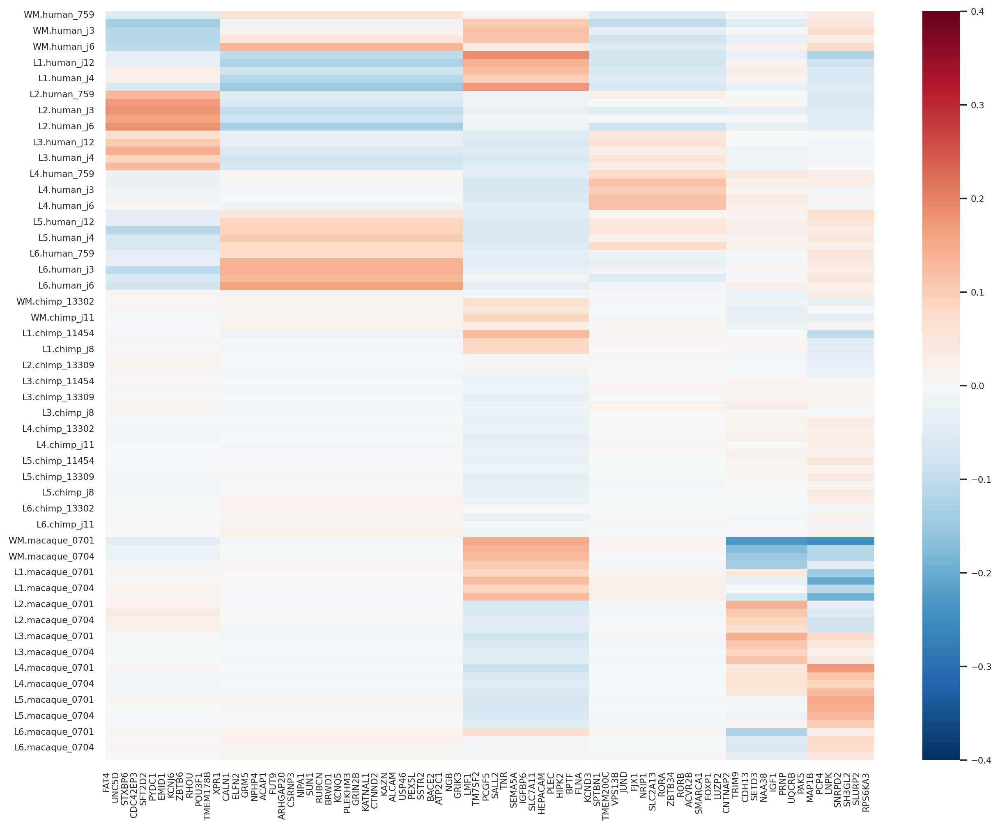

In [66]:
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(sample_mean.loc[sample_order['all'], order], ax=ax, cmap="RdBu_r", vmin=-0.4, vmax=0.4, center=0)
plt.savefig('heatmap_spectr_hs_mean.png', bbox_inches='tight')